<span style="font-size: 14px;"><b>Problem Statement:</b><br>
AdEase aims to optimize ad placements on Wikipedia pages by forecasting the number of page views. Given that different Wikipedia pages attract varying levels of attention based on language, access type, and origin, it's essential to predict future page views accurately. This will allow AdEase to provide its clients with data-driven insights on where to place ads for maximum impact.</span>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
from datetime import datetime,timedelta
import warnings
warnings.filterwarnings('ignore')
from collections import Counter
import time
import re
import pickle
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from itertools import product

from copy import deepcopy
from beautifultable import BeautifulTable
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

#2015-07-01 till 2016-12-31

In [2]:
wikipedia_languages=[
    "en",  # English
    "de",  # German
    "fr",  # French
    "nl",  # Dutch
    "it",  # Italian
    "es",  # Spanish
    "sv",  # Swedish
    "ru",  # Russian
    "pl",  # Polish
    "ja",  # Japanese
    "pt",  # Portuguese
    "zh",  # Chinese
    "vi",  # Vietnamese
    "ar",  # Arabic
    "hu",  # Hungarian
    "fi",  # Finnish
    "cs",  # Czech
    "ro",  # Romanian
    "ko",  # Korean
    "el",  # Greek
    "da",  # Danish
    "no",  # Norwegian Bokmål
    "tr",  # Turkish
    "th",  # Thai
    "he",  # Hebrew
    "id",  # Indonesian
    "uk",  # Ukrainian
    "ca",  # Catalan
    "sr",  # Serbian
    "bg",  # Bulgarian
    "hr",  # Croatian
    "sk",  # Slovak
    "lt",  # Lithuanian
    "sl",  # Slovenian
    "et",  # Estonian
    "lv",  # Latvian
    "fa",  # Persian
    "ms",  # Malay
    "bn",  # Bengali
    "hi",  # Hindi
    "te",  # Telugu
    "ta",  # Tamil
    "kn",  # Kannada
    "mr",  # Marathi
    "gu",  # Gujarati
    "pa",  # Punjabi
    "ur",  # Urdu
    "sw",  # Swahili
    "af",  # Afrikaans
    "eo",  # Esperanto
    "eu",  # Basque
    "gl",  # Galician
    "is",  # Icelandic
    "mk",  # Macedonian
    "mn",  # Mongolian
    "hy",  # Armenian
    "ka",  # Georgian
    "bs",  # Bosnian
    "sq",  # Albanian
    "az",  # Azerbaijani
    "br",  # Breton
    "cy",  # Welsh
    "ht",  # Haitian Creole
    "lb",  # Luxembourgish
    "mt",  # Maltese
    "ml",  # Malayalam
    "ne",  # Nepali
    "nn",  # Norwegian Nynorsk
    "ps",  # Pashto
    "sd",  # Sindhi
    "tt",  # Tatar
    "yo"   # Yoruba
]  

In [3]:
data=pd.read_csv(r'Ad_ease_data\train_1.csv')

## sorting the datetime columns 
data=data.loc[:,[data.columns[0]]+sorted(data.columns[1:])].copy()

## Removing rows with more than x% null values
perc_nulls=30

d_nulldata=data.iloc[:,1:].copy()
d_nulldata=(100/d_nulldata.shape[1])*d_nulldata.isna().sum(axis=1)

length=len(data)
perc=100*len(data.loc[d_nulldata>=perc_nulls])/len(data)
print("Rows with >{}% nulls constitute {}% of dataset".format(perc_nulls,round(perc,2)))

data=data.loc[d_nulldata<perc_nulls].copy()
data.reset_index(inplace=True,drop=True)

Rows with >30% nulls constitute 10.69% of dataset


In [4]:
data.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,2015-07-11,2015-07-12,2015-07-13,2015-07-14,2015-07-15,2015-07-16,2015-07-17,2015-07-18,2015-07-19,2015-07-20,2015-07-21,2015-07-22,2015-07-23,2015-07-24,2015-07-25,2015-07-26,2015-07-27,2015-07-28,2015-07-29,2015-07-30,2015-07-31,2015-08-01,2015-08-02,2015-08-03,2015-08-04,2015-08-05,2015-08-06,2015-08-07,2015-08-08,2015-08-09,2015-08-10,2015-08-11,2015-08-12,2015-08-13,2015-08-14,2015-08-15,2015-08-16,2015-08-17,2015-08-18,2015-08-19,2015-08-20,2015-08-21,2015-08-22,2015-08-23,2015-08-24,2015-08-25,2015-08-26,2015-08-27,2015-08-28,2015-08-29,2015-08-30,2015-08-31,2015-09-01,2015-09-02,2015-09-03,2015-09-04,2015-09-05,2015-09-06,2015-09-07,2015-09-08,2015-09-09,2015-09-10,2015-09-11,2015-09-12,2015-09-13,2015-09-14,2015-09-15,2015-09-16,2015-09-17,2015-09-18,2015-09-19,2015-09-20,2015-09-21,2015-09-22,2015-09-23,2015-09-24,2015-09-25,2015-09-26,2015-09-27,2015-09-28,2015-09-29,2015-09-30,2015-10-01,2015-10-02,2015-10-03,2015-10-04,2015-10-05,2015-10-06,2015-10-07,2015-10-08,2015-10-09,2015-10-10,2015-10-11,2015-10-12,2015-10-13,2015-10-14,2015-10-15,2015-10-16,2015-10-17,2015-10-18,2015-10-19,2015-10-20,2015-10-21,2015-10-22,2015-10-23,2015-10-24,2015-10-25,2015-10-26,2015-10-27,2015-10-28,2015-10-29,2015-10-30,2015-10-31,2015-11-01,2015-11-02,2015-11-03,2015-11-04,2015-11-05,2015-11-06,2015-11-07,2015-11-08,2015-11-09,2015-11-10,2015-11-11,2015-11-12,2015-11-13,2015-11-14,2015-11-15,2015-11-16,2015-11-17,2015-11-18,2015-11-19,2015-11-20,2015-11-21,2015-11-22,2015-11-23,2015-11-24,2015-11-25,2015-11-26,2015-11-27,2015-11-28,2015-11-29,2015-11-30,2015-12-01,2015-12-02,2015-12-03,2015-12-04,2015-12-05,2015-12-06,2015-12-07,2015-12-08,2015-12-09,2015-12-10,2015-12-11,2015-12-12,2015-12-13,2015-12-14,2015-12-15,2015-12-16,2015-12-17,2015-12-18,2015-12-19,2015-12-20,2015-12-21,2015-12-22,2015-12-23,2015-12-24,2015-12-25,2015-12-26,2015-12-27,2015-12-28,2015-12-29,2015-12-30,2015-12-31,2016-01-01,2016-01-02,2016-01-03,2016-01-04,2016-01-05,2016-01-06,2016-01-07,2016-01-08,2016-01-09,2016-01-10,2016-01-11,2016-01-12,2016-01-13,2016-01-14,2016-01-15,2016-01-16,2016-01-17,2016-01-18,2016-01-19,2016-01-20,2016-01-21,2016-01-22,2016-01-23,2016-01-24,2016-01-25,2016-01-26,2016-01-27,2016-01-28,2016-01-29,2016-01-30,2016-01-31,2016-02-01,2016-02-02,2016-02-03,2016-02-04,2016-02-05,2016-02-06,2016-02-07,2016-02-08,2016-02-09,2016-02-10,2016-02-11,2016-02-12,2016-02-13,2016-02-14,2016-02-15,2016-02-16,2016-02-17,2016-02-18,2016-02-19,2016-02-20,2016-02-21,2016-02-22,2016-02-23,2016-02-24,2016-02-25,2016-02-26,2016-02-27,2016-02-28,2016-02-29,2016-03-01,2016-03-02,2016-03-03,2016-03-04,2016-03-05,...,2016-04-26,2016-04-27,2016-04-28,2016-04-29,2016-04-30,2016-05-01,2016-05-02,2016-05-03,2016-05-04,2016-05-05,2016-05-06,2016-05-07,2016-05-08,2016-05-09,2016-05-10,2016-05-11,2016-05-12,2016-05-13,2016-05-14,2016-05-15,2016-05-16,2016-05-17,2016-05-18,2016-05-19,2016-05-20,2016-05-21,2016-05-22,2016-05-23,2016-05-24,2016-05-25,2016-05-26,2016-05-27,2016-05-28,2016-05-29,2016-05-30,2016-05-31,2016-06-01,2016-06-02,2016-06-03,2016-06-04,2016-06-05,2016-06-06,2016-06-07,2016-06-08,2016-06-09,2016-06-10,2016-06-11,2016-06-12,2016-06-13,2016-06-14,2016-06-15,2016-06-16,2016-06-17,2016-06-18,2016-06-19,2016-06-20,2016-06-21,2016-06-22,2016-06-23,2016-06-24,2016-06-25,2016-06-26,2016-06-27,2016-06-28,2016-06-29,2016-06-30,2016-07-01,2016-07-02,2016-07-03,2016-07-04,2016-07-05,2016-07-06,2016-07-07,2016-07-08,2016-07-09,2016-07-10,2016-07-11,2016-07-12,2016-07-13,2016-07-14,2016-07-15,2016-07-16,2016-07-17,2016-07-18,2016-07-19,2016-07-20,2016-07-21,2016-07-22,2016-07-23,2016-07-24,2016-07-25,2016-07-26,2016-07-27,2016-07-28,2016-07-29,2016-07-30,2016-07-31,2016-08-01,2016-08-02,2016-08-03,2016-08-04,2016-08-05,2016-08-06,2016-08-07,2016-08-08,2016-08-09,2016-08-10,2016-08-11,2016-08-12,2016-08-13,2016-08-14,2016-08-15,2016-08-16,2016-08-

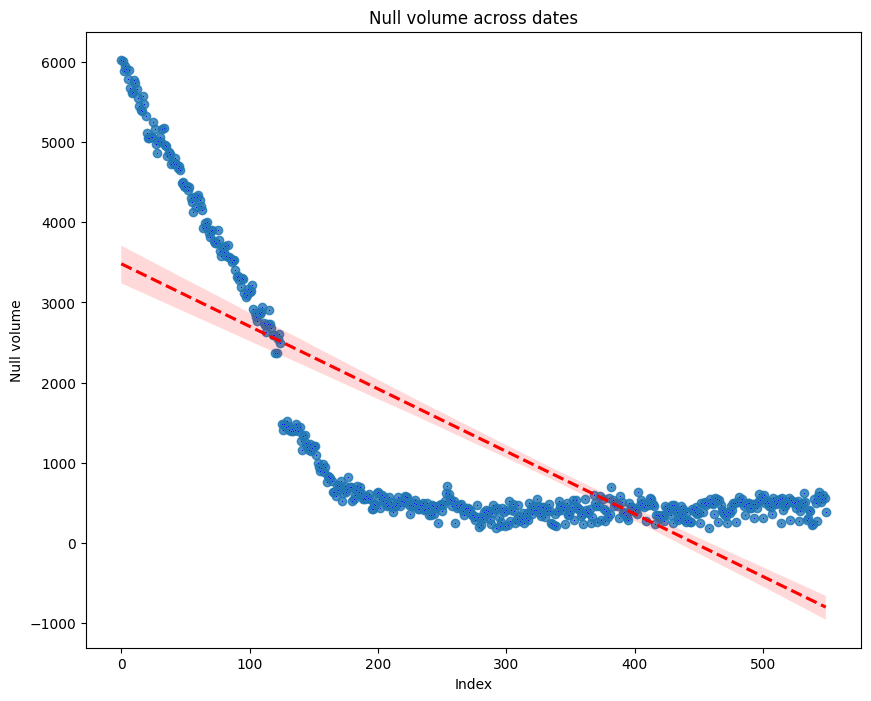

In [5]:
dt=data.iloc[:,1:].isna().sum(axis=0).to_frame()
dt.columns=['nulls']
dt['x']=pd.Series(list(range(0,len(dt))),index=dt.index)

plt.figure(figsize=(10,8))
sns.regplot(data=dt,x='x',y='nulls',line_kws={'color':'red','linestyle':'--'})
sns.scatterplot(data=dt,x='x',y='nulls',color='blue',s=1)
plt.xlabel('Index')
plt.ylabel('Null volume')
plt.title('Null volume across dates')
plt.show() 


## the earlier exponentially high nulls explains a lot of these pages didn't exist during earlier part of timeline

In [6]:
## max null consecutive days per row
max_consecutive_nulls=3

d_nulldata_consecutive_days=data.iloc[:,1:].copy()
d_nulldata_consecutive_days.replace(np.nan,-1,inplace=True)

for col in d_nulldata_consecutive_days.columns:
    d_nulldata_consecutive_days.loc[d_nulldata_consecutive_days[col]>-1,col]=1
    
d_nulldata_consecutive_days.replace(-1,0,inplace=True)
d_nulldata_consecutive_days=d_nulldata_consecutive_days.apply(lambda x:''.join([str(round(j)) for j in list(x.values)]),axis=1)

d_nulldata_consecutive_days=d_nulldata_consecutive_days.apply(lambda x:[len(j) for j in re.findall(r'[0]+',x)])

d_nulldata_consecutive_days1=d_nulldata_consecutive_days.apply(lambda x:max(x) if len(x) else 0)

data=data.loc[d_nulldata_consecutive_days1<=max_consecutive_nulls].copy()


print("% data working with: {}".format(100*len(data)/length))

% data working with: 84.78798866699296


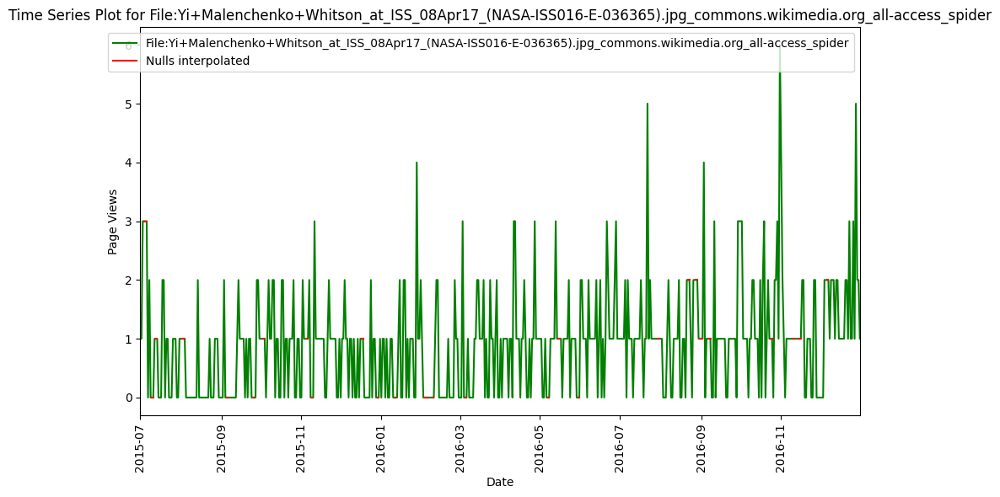

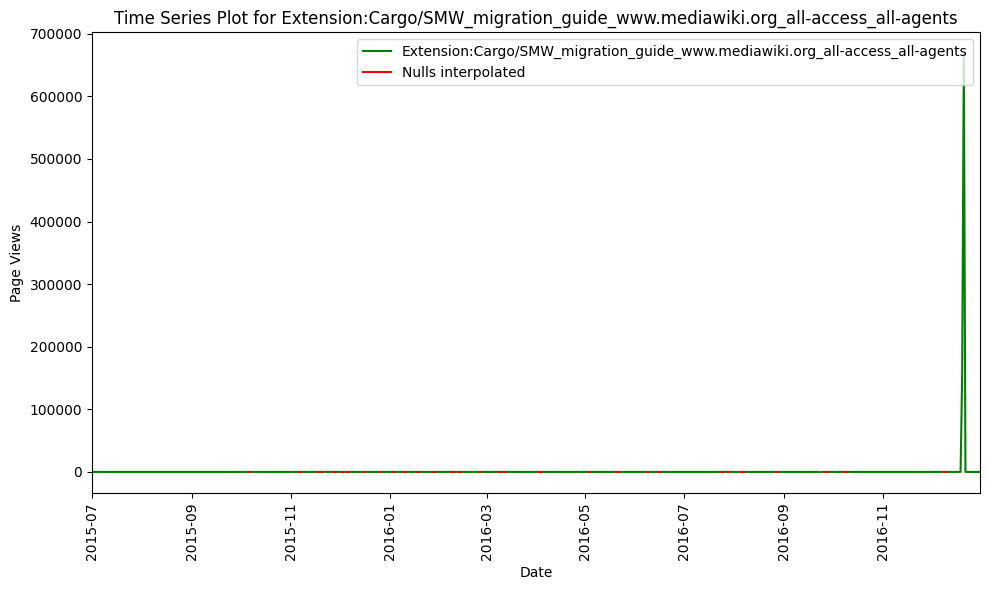

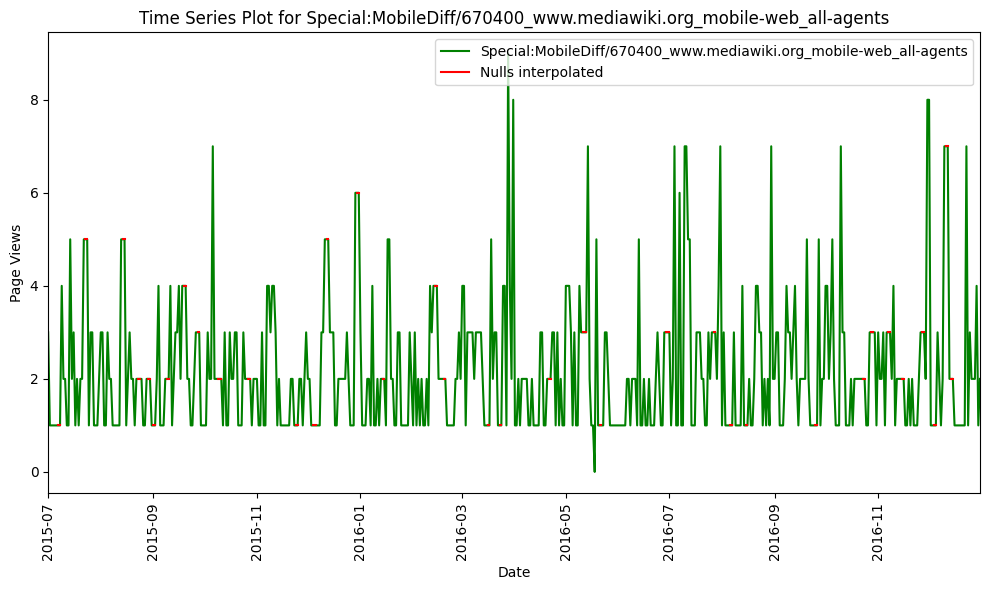

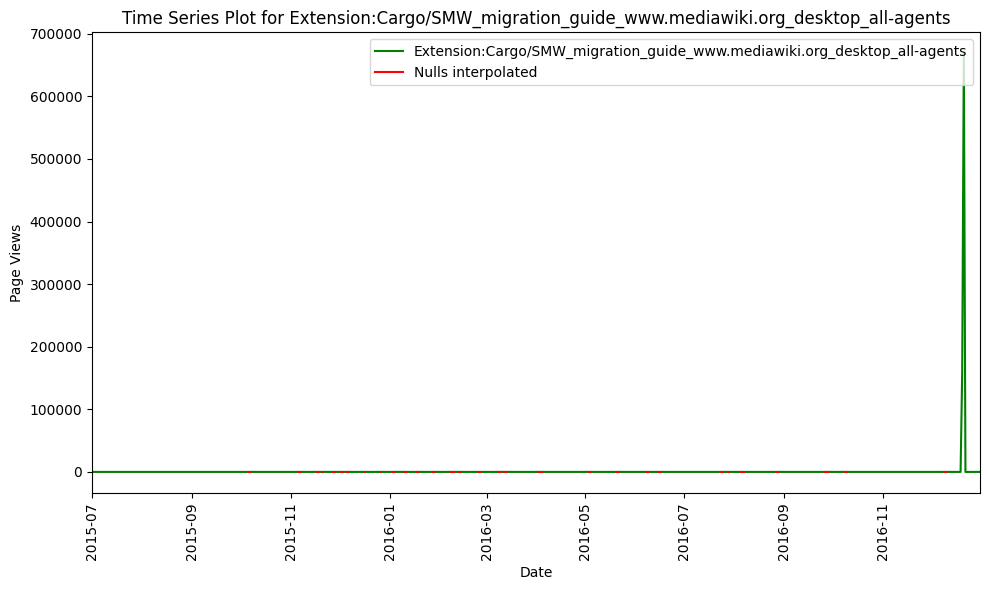

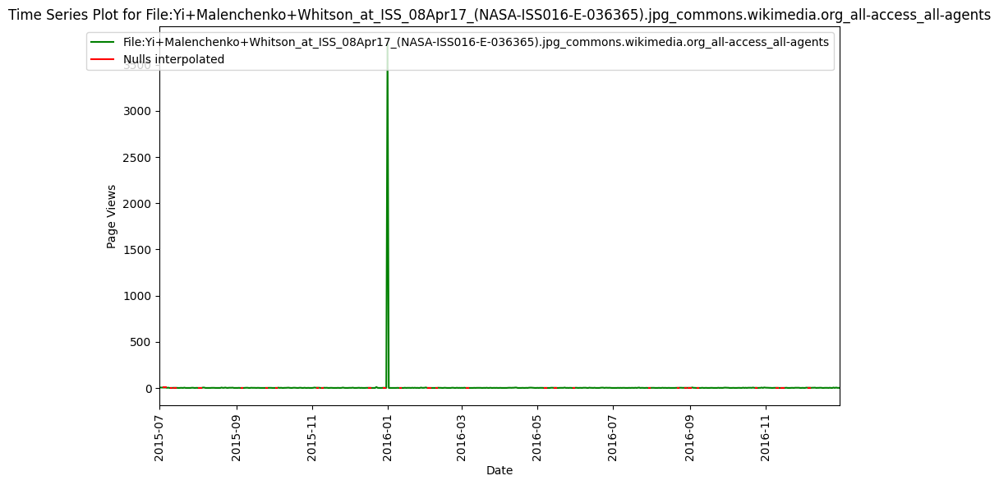

...

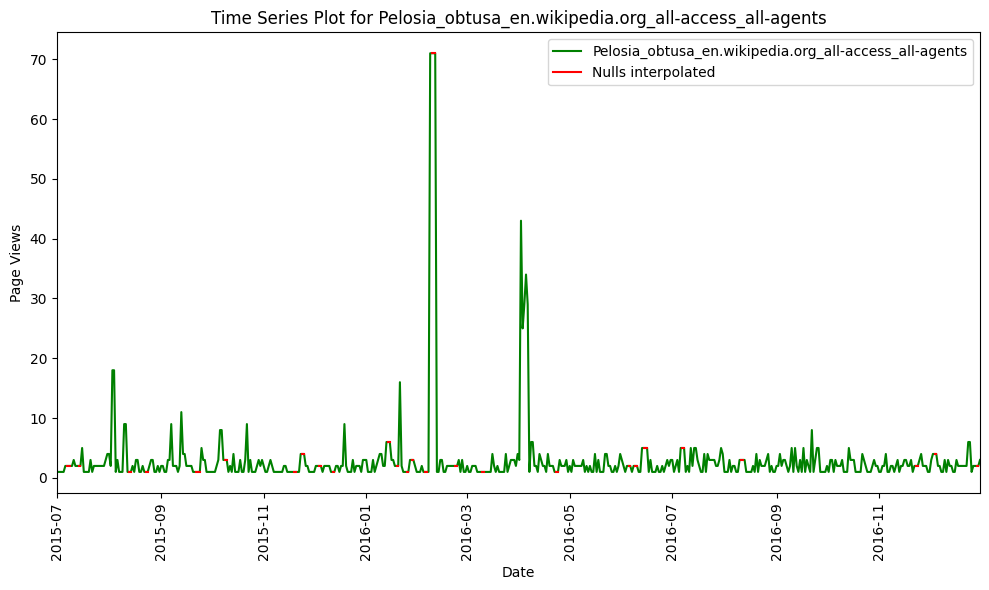

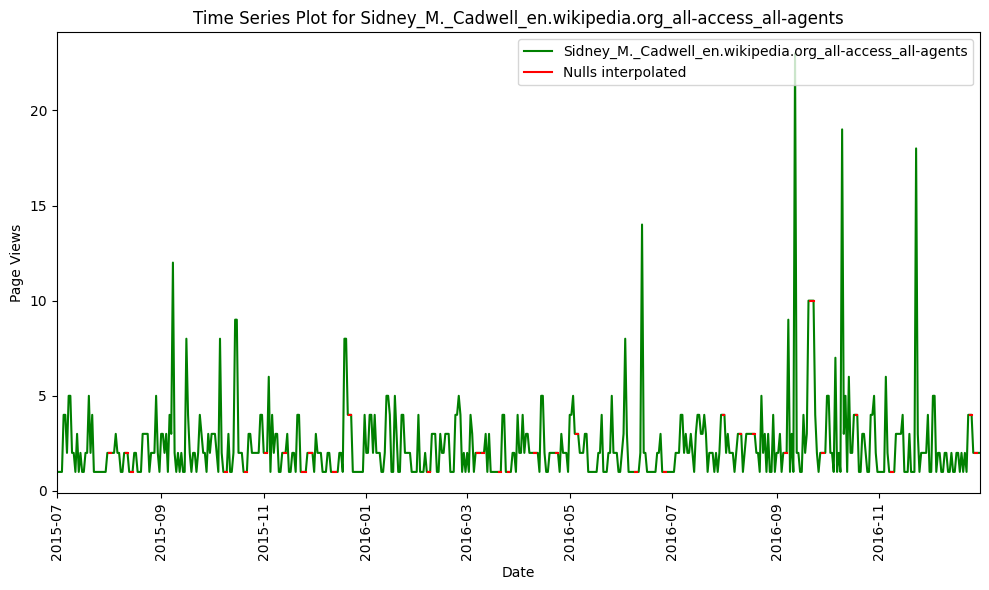

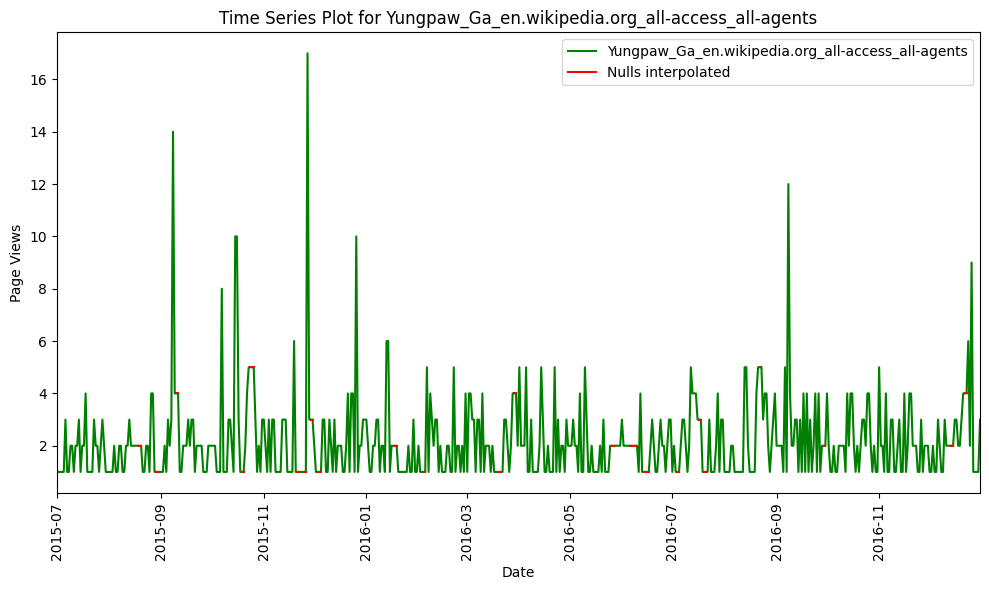

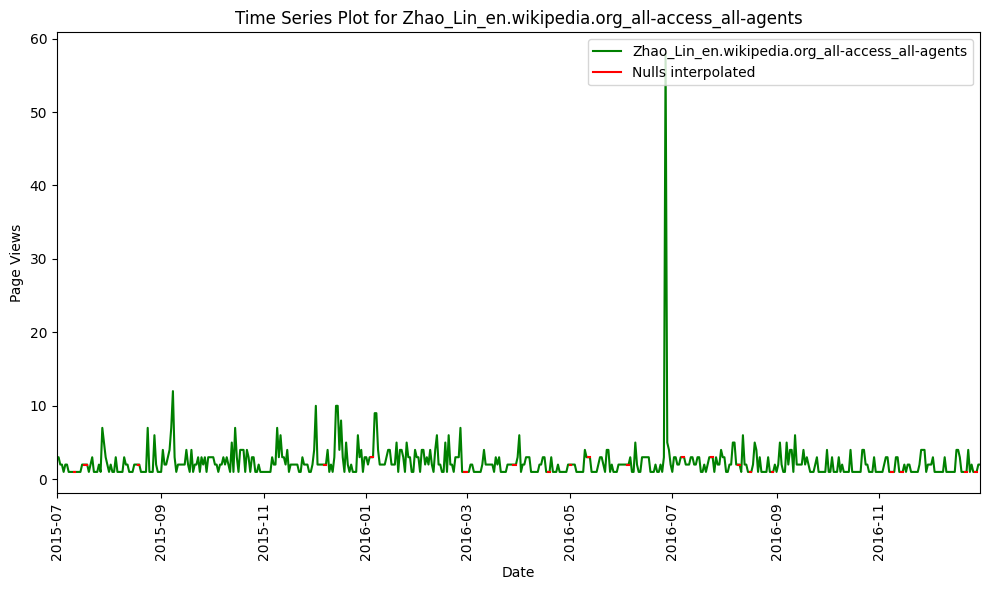

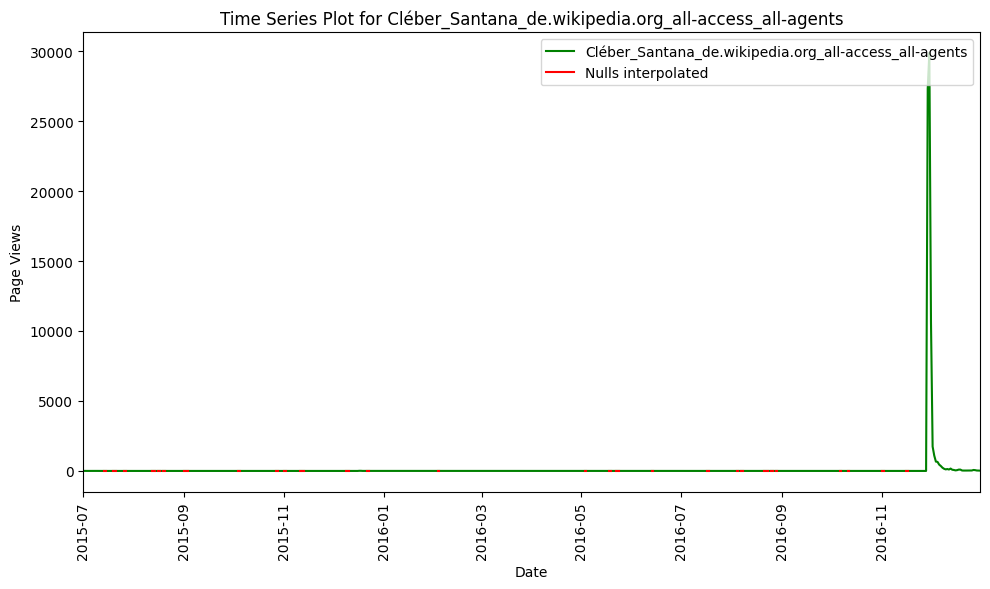

In [7]:
## Plotting to see if linear interpolation and forward fill and backward fill imputations work on extreme rows(rows with multiple cases of consecutive nulls)

max_null_data = data.loc[d_nulldata_consecutive_days.apply(lambda x:len(x))>100, :].copy()

max_null_data.set_index('Page', inplace=True)

# Transpose the DataFrame to have dates as the index
max_null_data_t = max_null_data.transpose()
max_null_data_t.index=pd.to_datetime(max_null_data_t.index,errors='coerce')


# Plotting each row separately
for page in max_null_data_t.columns:
    
    max_null_data_t['null_color']=0
    max_null_data_t.loc[max_null_data_t[page].isna(),'null_color']=1
    
    
    
    max_null_data_t.loc[:,page]=max_null_data_t[[page]].interpolate(method='linear', axis=1).ffill().bfill()
    max_null_data_t['nulls']=np.nan
    max_null_data_t.loc[max_null_data_t['null_color']==1,'nulls']=max_null_data_t.loc[max_null_data_t['null_color']==1,page]
    
    plt.figure(figsize=(10, 6))
    plt.plot(max_null_data_t.index, max_null_data_t[page], label=page,color='green')
    
    plt.plot(max_null_data_t.index, max_null_data_t['nulls'], label='Nulls interpolated',color='red')
    plt.xlabel('Date')
    plt.ylabel('Page Views')
    plt.title(f'Time Series Plot for {page}')
    plt.legend(loc='upper right')
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.xlim(max_null_data_t.index.min(),max_null_data_t.index.max())
    plt.show()
    
    max_null_data_t.drop('null_color',axis=1,inplace=True)
    max_null_data_t.drop('nulls',axis=1,inplace=True)





data.reset_index(inplace=True,drop=True)

In [8]:
## extracting all wikipedia languages 

info=data.Page.str.lower().str.split(r'.wikipedia.org_|.wikimedia.org_|_www.mediawiki.org_',expand=True)
info[['specific_name','language']]=info.iloc[:,0].str.extract(r'^(.*)[_/]([^_/]+)$')
info.loc[info.specific_name.isna(),'specific_name']=info.loc[info.specific_name.isna(),0]

info[['access_type','access_origin']]=info.iloc[:,1].str.rsplit('_',n=1,expand=True)
info=info.iloc[:,2:].copy()


info=info.loc[info.language.isin(wikipedia_languages)].copy()

data=data.loc[info.index].copy()
data.reset_index(drop=True,inplace=True)
info.reset_index(drop=True,inplace=True)

In [9]:
## labelling languages<0.1% of dataset as 'other'

c=info.language.value_counts(normalize=True)
info.loc[info.language.isin(c[c<0.001].index),'language']='other'

In [10]:
from beautifultable import BeautifulTable

for col in info.columns[1:]:
    print('============\n{} value counts\n============'.format(col))
    cc=info[col].value_counts(normalize=True).reset_index()
    table = BeautifulTable()
    for ind,row in cc.iterrows():
        table.rows.append(row)
    table.columns.header = cc.columns
    print(table)

language value counts
+-------+----------+
| index | language |
+-------+----------+
|  en   |   0.18   |
+-------+----------+
|  ja   |  0.165   |
+-------+----------+
|  de   |  0.147   |
+-------+----------+
|  fr   |  0.143   |
+-------+----------+
|  ru   |  0.121   |
+-------+----------+
|  zh   |   0.12   |
+-------+----------+
|  es   |  0.115   |
+-------+----------+
| other |  0.008   |
+-------+----------+
access_type value counts
+------------+-------------+
|   index    | access_type |
+------------+-------------+
| all-access |    0.515    |
+------------+-------------+
| mobile-web |    0.249    |
+------------+-------------+
|  desktop   |    0.236    |
+------------+-------------+
access_origin value counts
+------------+---------------+
|   index    | access_origin |
+------------+---------------+
| all-agents |     0.757     |
+------------+---------------+
|   spider   |     0.243     |
+------------+---------------+


In [11]:
# 75.7% pages were viewed by agents and rest were spider(general public views)
# 51.5% pages are all access type
# Top 3 language pages are english(18%), japanese(16.5%) and german(14.7%)



In [12]:
import plotly.express as px

def dist_plot(d1,d2,cols):
    for col in cols:
         
        for label in d1[col].unique():
            plt.figure(figsize=(12, 6))
            indexes=d1[col]==label
            dd=d2.loc[indexes].copy()
            
            dd1=dd.loc[:,dd.columns[1:]].mean(axis=1).round().sort_values()
            dd1.index=dd.Page
            
            
            fig = px.line(x=list(range(len(dd1))), y=dd1, labels={'x': 'Index', 'y': 'Range of views'}, title=f"Plot for {col}-{label}")
                
            mean_value = dd1.mean()
            

            fig.add_hline(y=mean_value, line_dash="dash", line_color="red"
                          , annotation_text="Mean: {} views in {}".format(round(mean_value),label)
                          , annotation_position="bottom right")
            
            fig.add_vline(x=0, line_dash="dash", line_color="red"
                          , annotation_text=f"Least viewed page: {d1.loc[d2.Page==dd1.index[0],'specific_name'].unique()[0]}"
                          , annotation_position="top right")
            fig.add_vline(x=len(dd1) - 1, line_dash="dash", line_color="red"
                          , annotation_text=f"Most viewed page({round(dd1.iloc[-1])} views): {d1.loc[d2.Page==dd1.index[-1],'specific_name'].unique()[0]}"
                          , annotation_position="top right")

            fig.update_layout(paper_bgcolor='rgba(0,0,0,0)',plot_bgcolor='rgba(0,0,0,0)',
                      xaxis=dict(showgrid=False,title='Index'
                                 #, range=[x0,x1] 
                                )
                      , xaxis_title_font=dict(color='black',size=14)
                      ,yaxis=dict(showgrid=False,title='Range of views'
                                , range=[0,mean_value+100] 
                                    )
                     , yaxis_title_font=dict(color='black',size=14)
                    
                      ,title_x=0.5
                     )




            fig.update_traces( textfont_size=10,textposition='middle right',textfont_color='#C00000'
                         ,marker=dict(line=dict(color='rgba(0,0,0,0)')))

            fig.update_xaxes(showline=True,linewidth=1,linecolor='black')
            fig.update_yaxes(showline=True,linewidth=1,linecolor='black')
            fig.show()
            
        
            
        
        
dist_plot(info,data,['language'])

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

In [13]:
#zh(358),fr(678), en(5065), ru(1032),de(939),ja(799),other(30),es(1290)

#49.7% of daily average views on english language pages followed by spanish langugae pages(12.6%)

In [14]:
dist_plot(info,data,['access_type'])

## most average daily views observed from desktop users (38%), followed by all-access users(32%)


<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

In [15]:
dist_plot(info,data,['access_origin'])
## most average daily views observed from all-agents (96%)

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

In [16]:
## Exogeneous variable

exog_d=pd.read_csv(r'Ad_ease_data\Exog_Campaign_eng')
exog_d
exog_d.index=data.columns[1:]

##it's just for pages in english, campaign or significant event that could affect the views for that day
##train this specifically for pages in english


In [17]:
## test-train split

test_dataset=data.loc[:,[data.columns[0]]+list(data.columns[-30:])].copy()
train_dataset=data.loc[:,data.columns[:-30]].copy()

In [18]:
def clip_outliers(dd):
    Q1 = dd.quantile(0.25,axis=1)
    Q3 = dd.quantile(0.75,axis=1)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    return lower_bound,upper_bound
 


def wide_transformations(data,lower_bound,upper_bound,is_train=True):
    data.loc[:,data.columns[1:]]=data.iloc[:,1:].interpolate(method='linear', axis=1).ffill(axis=1).bfill(axis=1)
    
    
    if is_train:
        lower_bound,upper_bound=clip_outliers(data.iloc[:,1:])
        data.loc[:,data.columns[1:]]=data.loc[:,data.columns[1:]].clip(lower_bound,upper_bound,axis=0)
        
    else:
        data.loc[:,data.columns[1:]]=data.loc[:,data.columns[1:]].clip(lower_bound,upper_bound,axis=0)
            
    
    return lower_bound,upper_bound,data
            
            
    
lower_bound,upper_bound,train_dataset=wide_transformations(train_dataset,None,None,True)
_,_,test_dataset=wide_transformations(test_dataset,lower_bound,upper_bound,False)


In [19]:
train_dataset=info.merge(train_dataset,how='right',left_index=True,right_index=True)
test_dataset=info.merge(test_dataset,how='right',left_index=True,right_index=True)

train_dataset2=train_dataset.groupby(['language']).agg({col:'mean' for col in train_dataset.columns[5:]})
test_dataset2=test_dataset.groupby(['language']).agg({col:'mean' for col in test_dataset.columns[5:]})

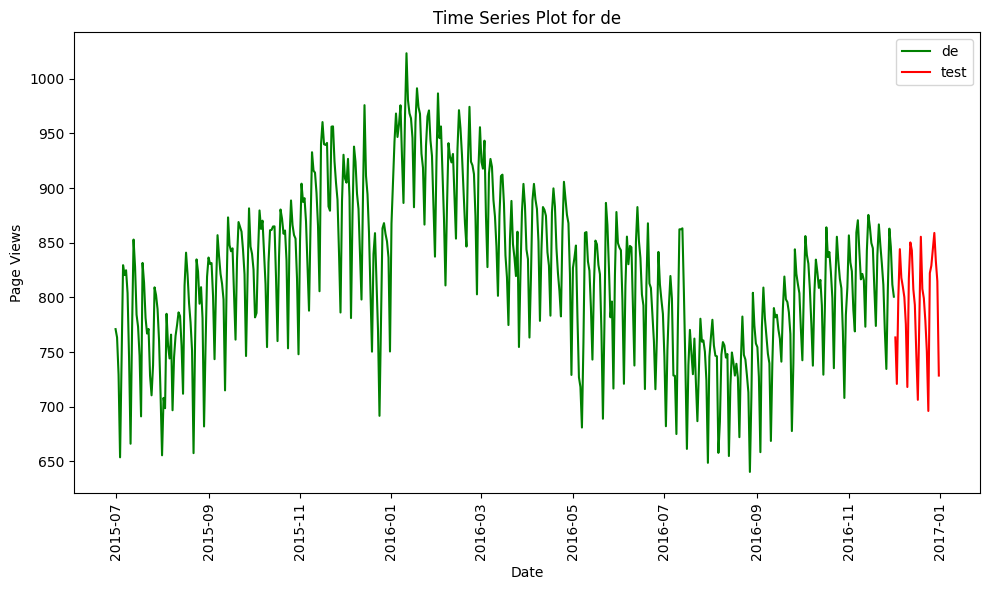

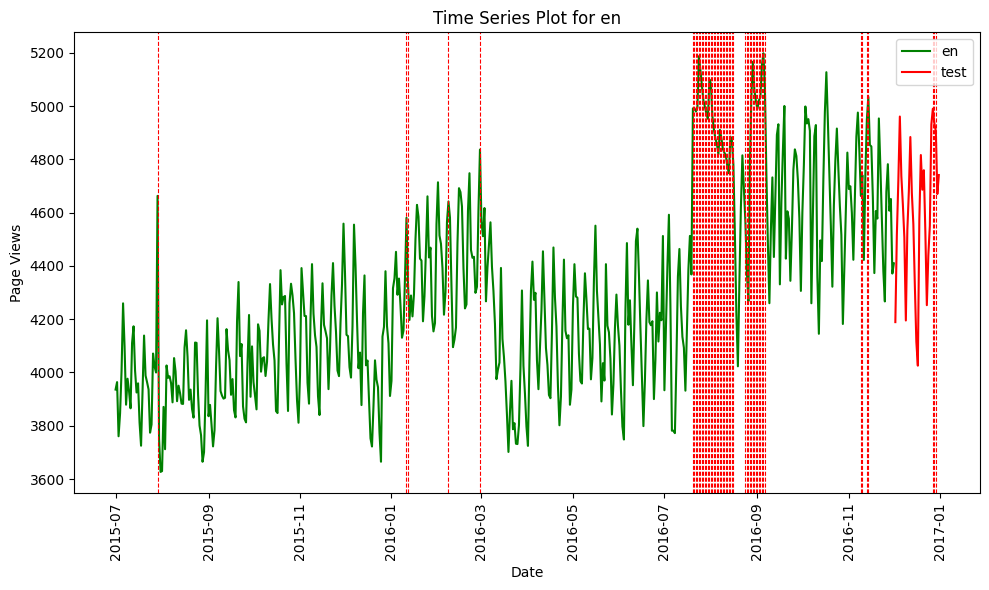

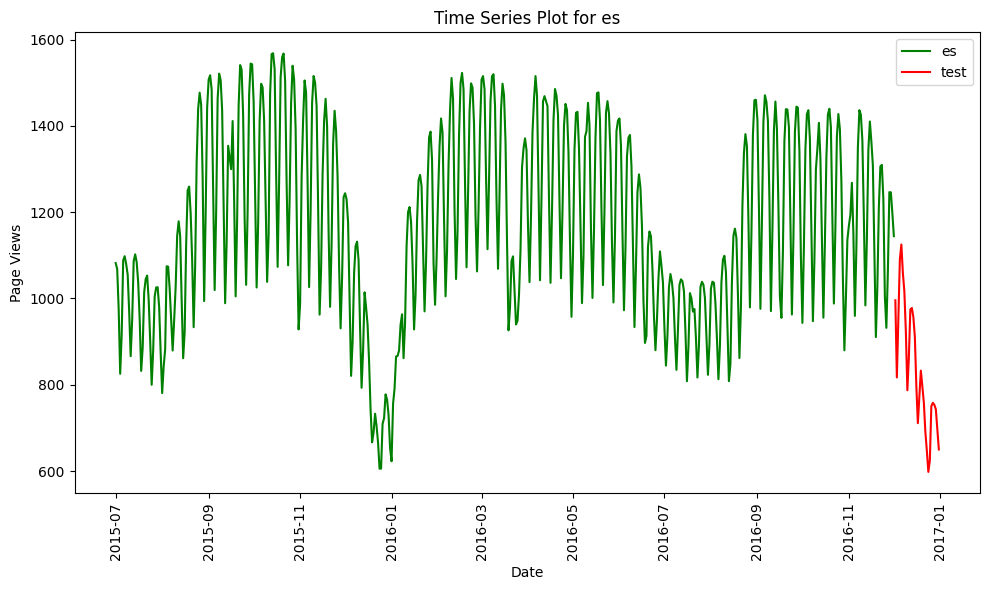

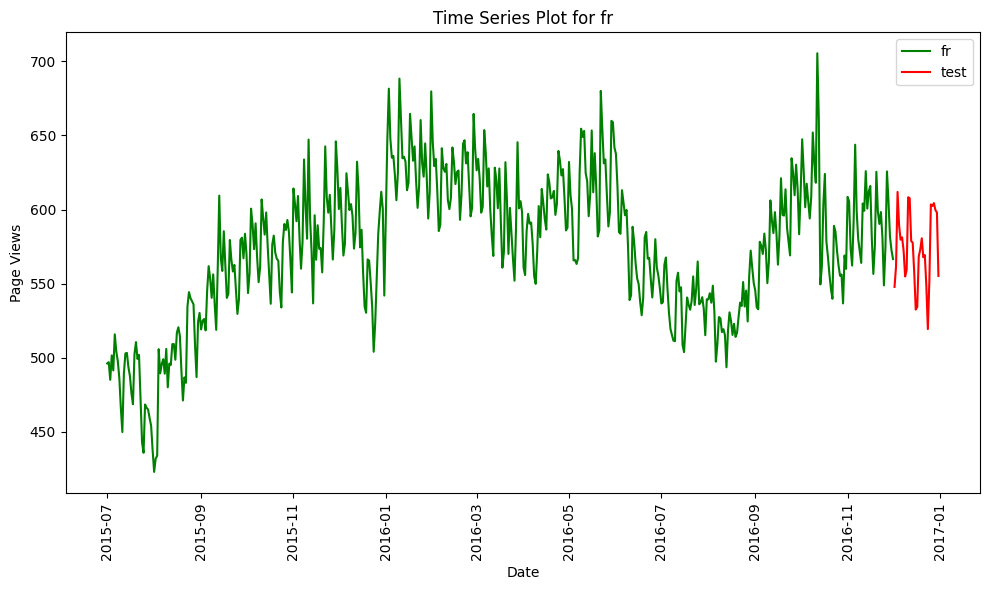

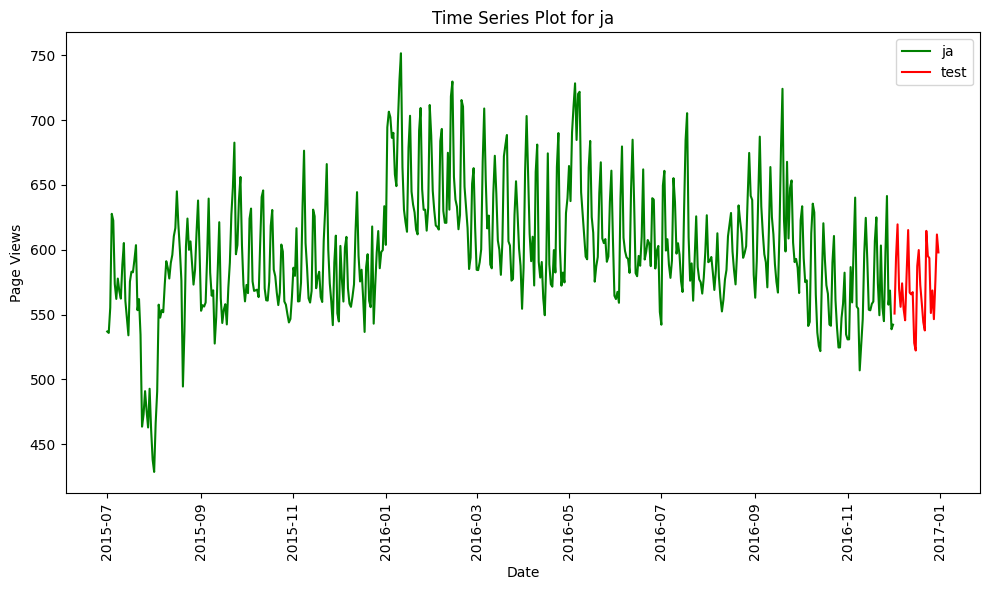

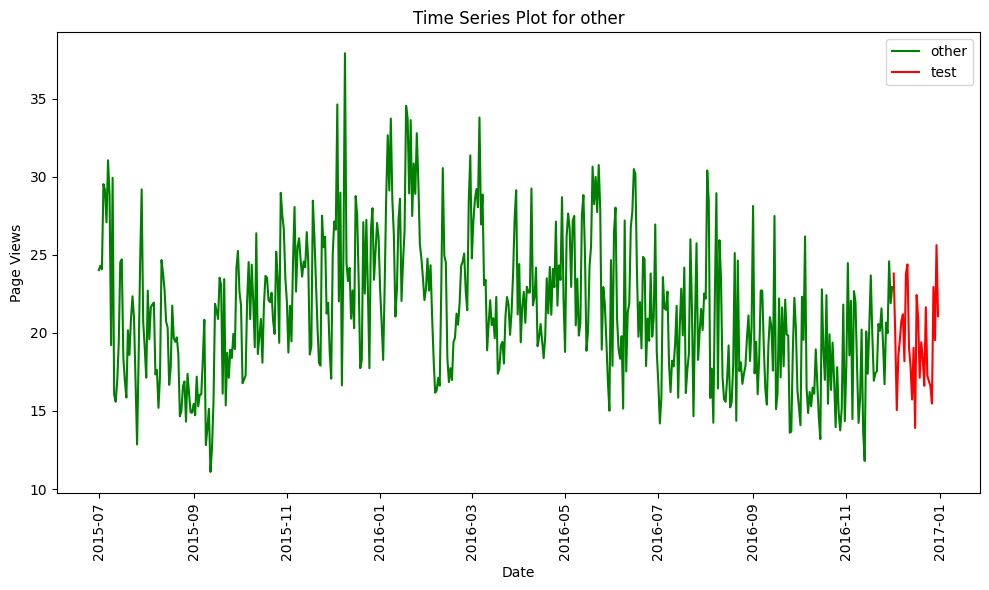

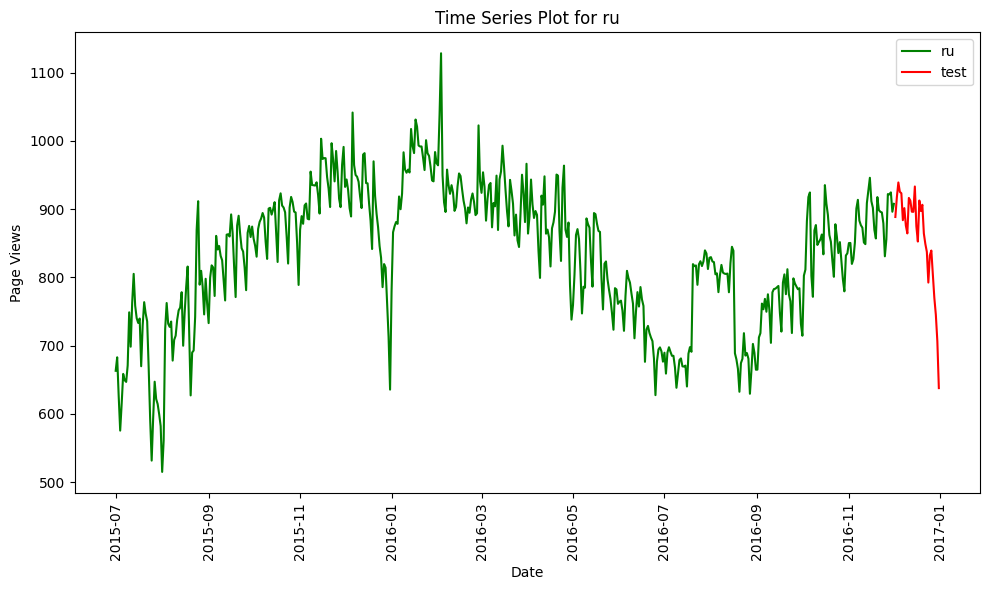

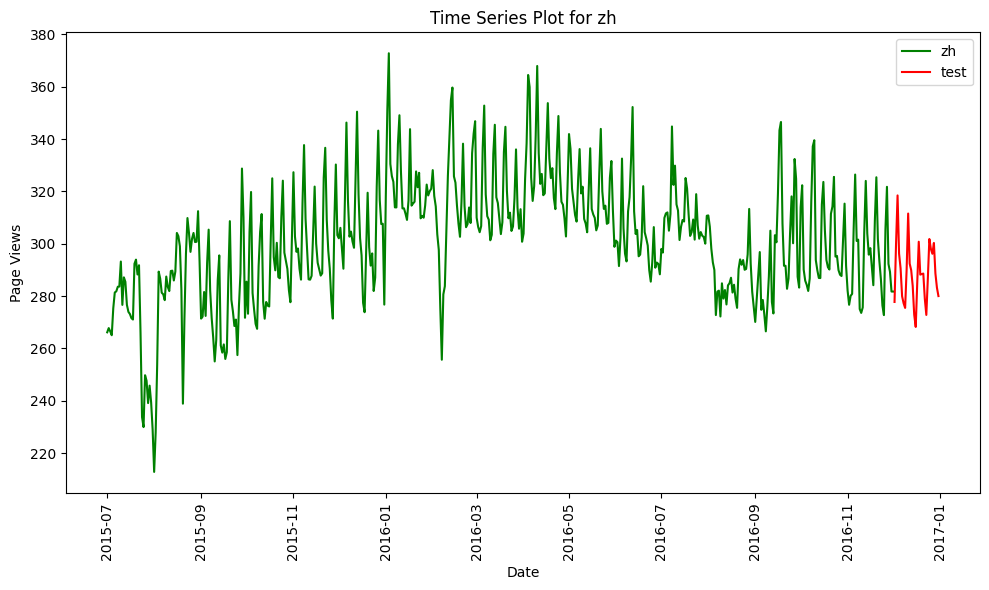

In [20]:
train_plot = train_dataset2.copy()
test_plot = test_dataset2.copy()

# Transpose the DataFrame to have dates as the index
train_plot_t = train_plot.transpose()
train_plot_t.index=pd.to_datetime(train_plot_t.index,errors='coerce')

test_plot_t = test_plot.transpose()
test_plot_t.index=pd.to_datetime(test_plot_t.index,errors='coerce')


# Plotting each row separately
for page in train_plot_t.columns:
    
    plt.figure(figsize=(10, 6))
    plt.plot(train_plot_t.index, train_plot_t[page], label=page,color='green')
    plt.plot(test_plot_t.index, test_plot_t[page], label='test',color='red')
    if page=='en':
        for idx in exog_d.loc[exog_d['Exog'] == 1].index:
            plt.axvline(x=pd.to_datetime(idx), color='red', linestyle='--', linewidth=0.8)
    
    plt.xlabel('Date')
    plt.ylabel('Page Views')
    plt.title(f'Time Series Plot for {page}')
    plt.legend(loc='upper right')
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.show()
    

In [21]:
#Doing TS analysis
from statsmodels.tsa.stattools import adfuller, acf, pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_pacf,plot_acf

def check_stationarity(timeseries):
    # Perform the Dickey-Fuller test
    result = adfuller(timeseries)
    print('ADF Statistic: %f' % result[0])
    print('p-value: %f' % result[1])
    
    
    if result[1] > 0.05:
        print("The time series is non-stationary.")
    else:
        print("The time series is stationary.")
    
    return result[1] > 0.05

def plot_decomposition(timeseries, model='additive'):
    decomposition = seasonal_decompose(timeseries, model=model)  #, period=freq
    
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(15, 8))
    decomposition.observed.plot(ax=ax1, title='Observed')
    decomposition.trend.plot(ax=ax2, title='Trend')
    decomposition.seasonal.plot(ax=ax3, title='Seasonal')
    
    decomposition.resid.plot(ax=ax4, title='Residual')
    plt.tight_layout()
    plt.show()

def plot_acf_pacf(timeseries, lags=40):
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 8))
    
    # Plot ACF
    plot_acf(timeseries.dropna(), lags=lags, ax=ax1)
    ax1.set_title('Autocorrelation Function')
    
    # Plot PACF
    plot_pacf(timeseries.dropna(), lags=lags, ax=ax2)
    ax2.set_title('Partial Autocorrelation Function')
    
    plt.tight_layout()
    plt.show()

def analyze_timeseries(timeseries, lags=40, model='additive', freq=None):
    
    timeseries.index=pd.to_datetime(timeseries.index)
    print("Checking stationarity...")
    for i in range(0,4):
        if i==0:
            tt=timeseries
        else:
            tt=timeseries.diff(i).iloc[i:]
        print("Checking stationarity by differencing {} times".format(i))
        cs=check_stationarity(tt)
        if cs==False:
            break
    
    print("\nDecomposing the time series...")
    plot_decomposition(timeseries, model=model)  #, freq=freq
    
    print("\nPlotting ACF and PACF...")
    plot_acf_pacf(timeseries, lags=lags)
    



LANGUAGES: de
Checking stationarity...
Checking stationarity by differencing 0 times
ADF Statistic: -1.786322
p-value: 0.387273
The time series is non-stationary.
Checking stationarity by differencing 1 times
ADF Statistic: -7.639842
p-value: 0.000000
The time series is stationary.

Decomposing the time series...


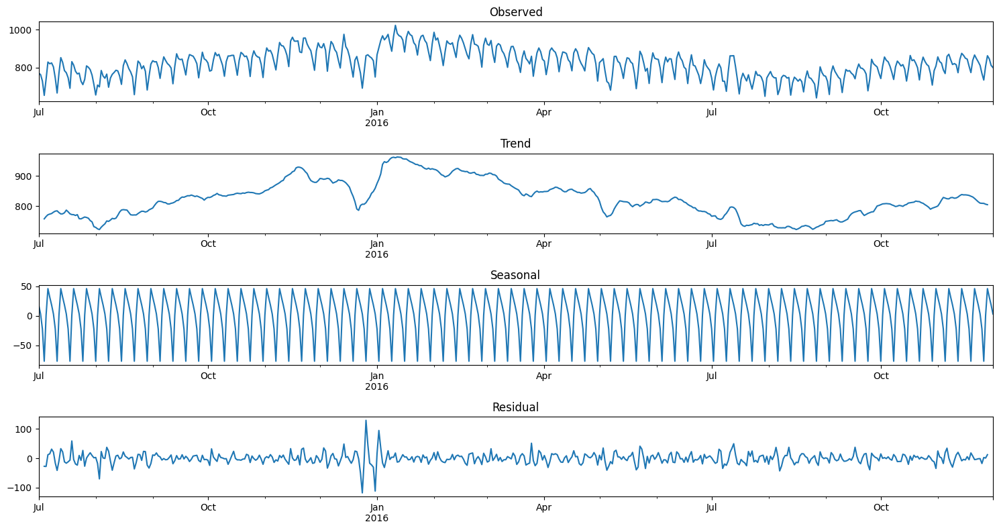


Plotting ACF and PACF...


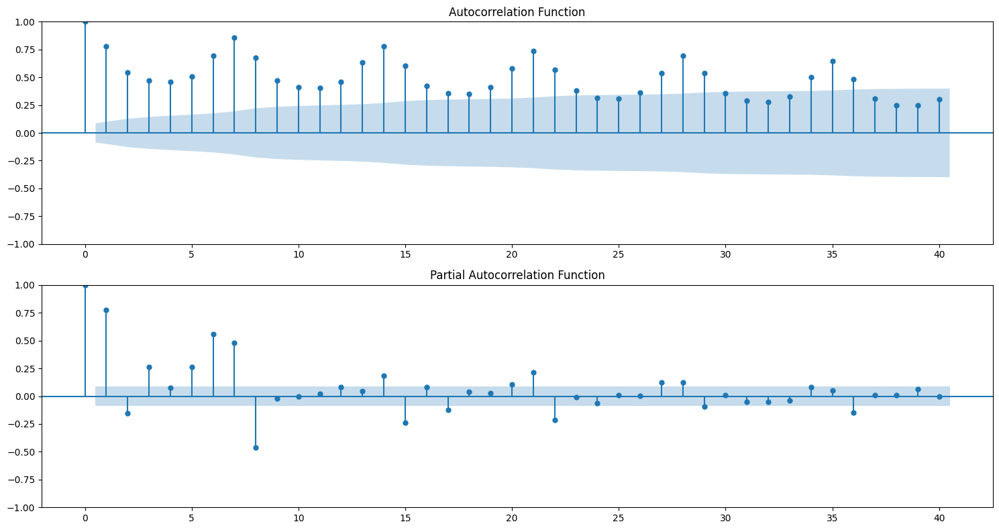

LANGUAGES: en
Checking stationarity...
Checking stationarity by differencing 0 times
ADF Statistic: -1.765115
p-value: 0.397914
The time series is non-stationary.
Checking stationarity by differencing 1 times
ADF Statistic: -7.969045
p-value: 0.000000
The time series is stationary.

Decomposing the time series...


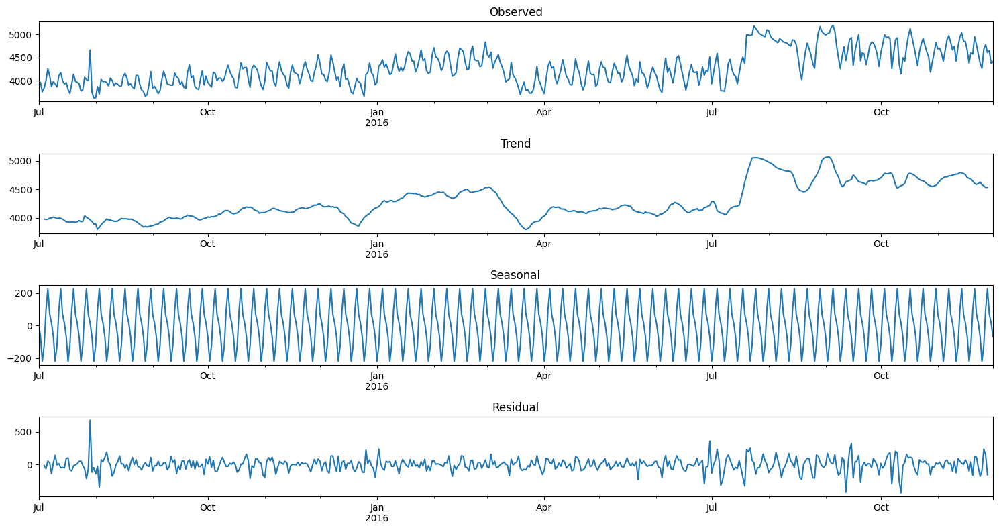


Plotting ACF and PACF...


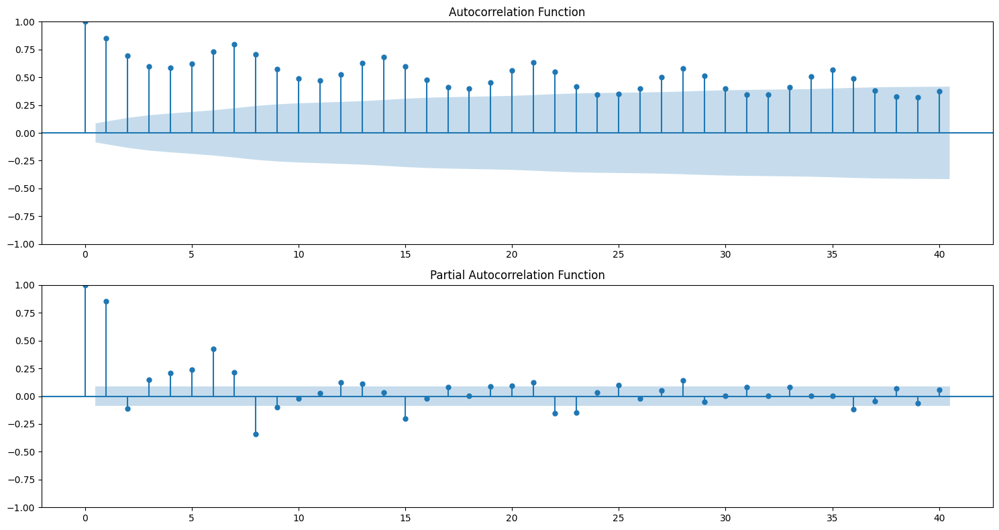

LANGUAGES: es
Checking stationarity...
Checking stationarity by differencing 0 times
ADF Statistic: -3.101519
p-value: 0.026441
The time series is stationary.

Decomposing the time series...


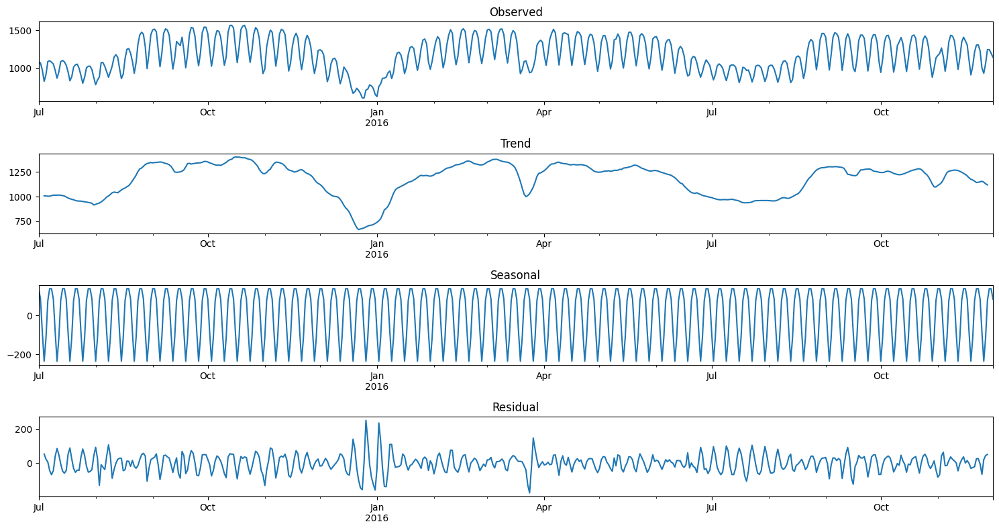


Plotting ACF and PACF...


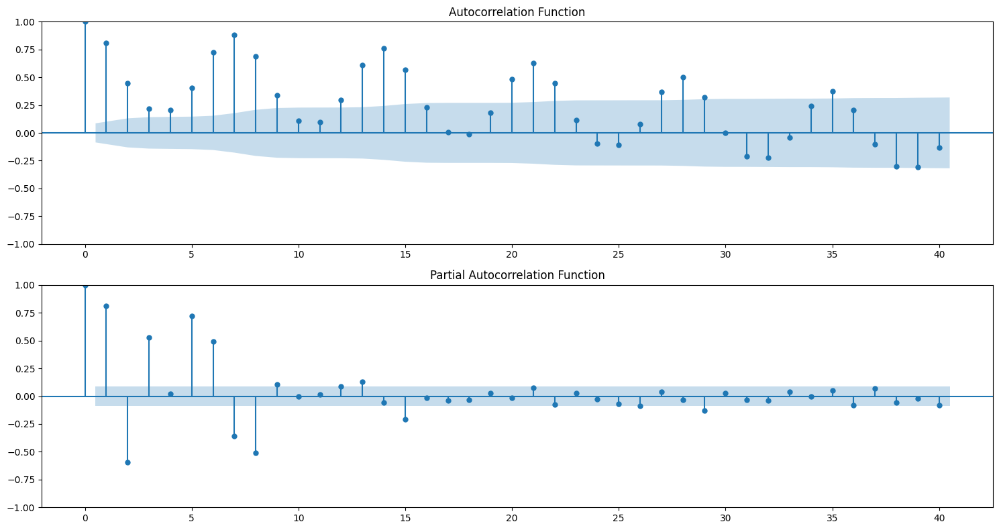

LANGUAGES: fr
Checking stationarity...
Checking stationarity by differencing 0 times
ADF Statistic: -2.231223
p-value: 0.195109
The time series is non-stationary.
Checking stationarity by differencing 1 times
ADF Statistic: -7.469044
p-value: 0.000000
The time series is stationary.

Decomposing the time series...


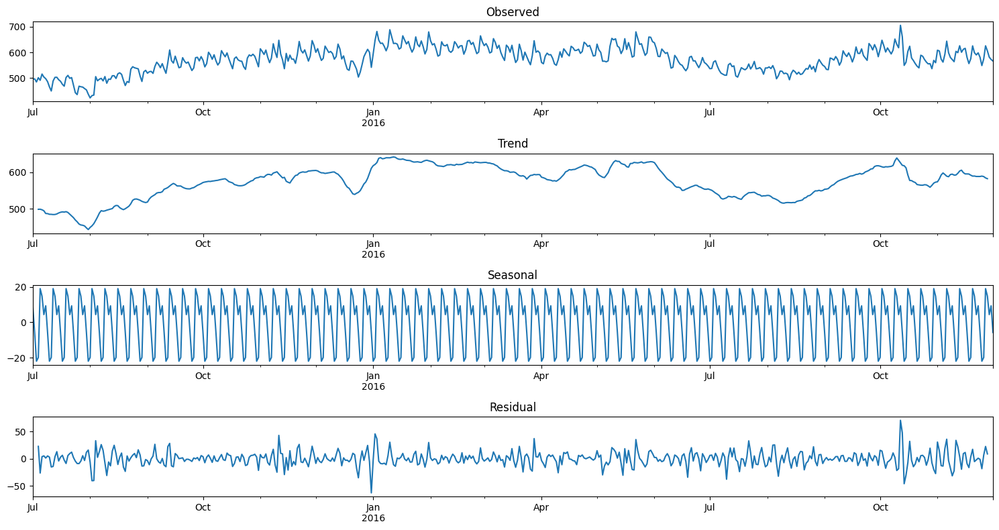


Plotting ACF and PACF...


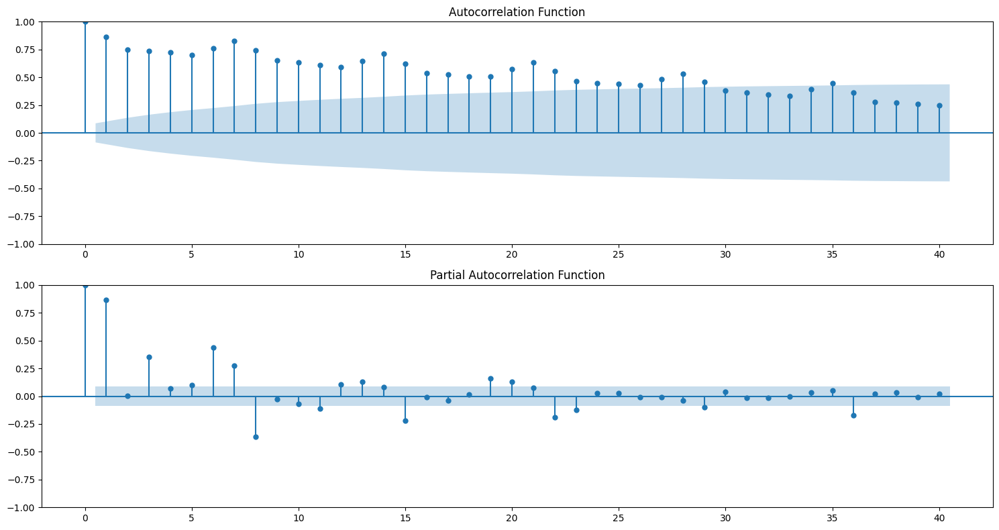

LANGUAGES: ja
Checking stationarity...
Checking stationarity by differencing 0 times
ADF Statistic: -2.532707
p-value: 0.107718
The time series is non-stationary.
Checking stationarity by differencing 1 times
ADF Statistic: -7.813480
p-value: 0.000000
The time series is stationary.

Decomposing the time series...


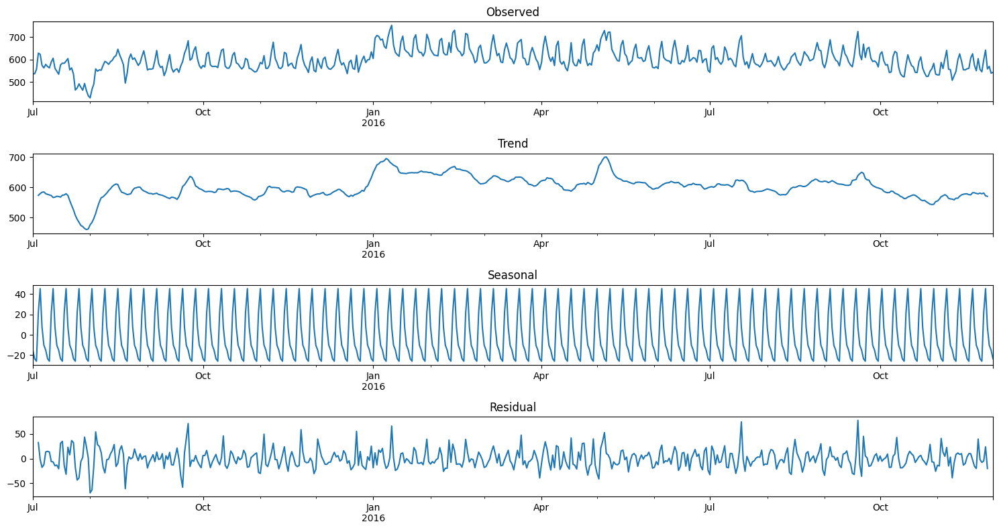


Plotting ACF and PACF...


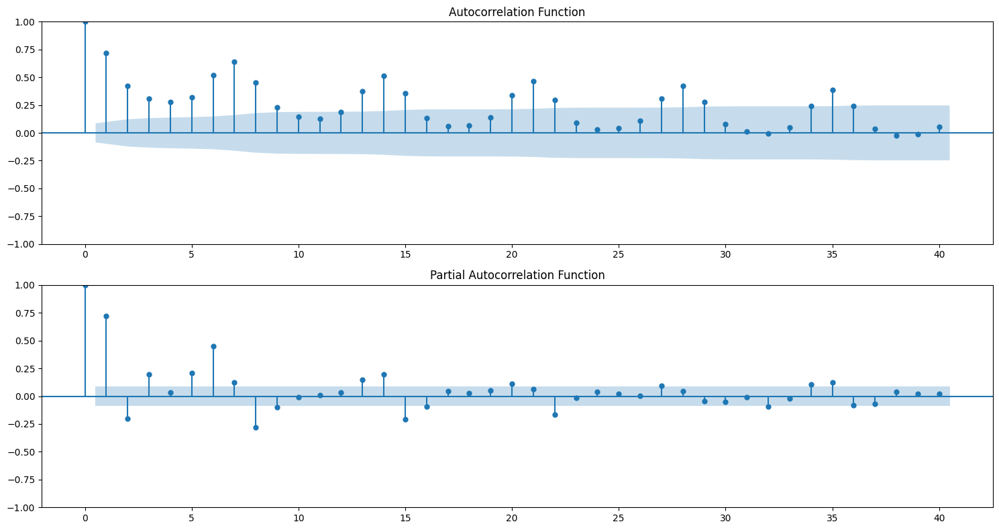

LANGUAGES: other
Checking stationarity...
Checking stationarity by differencing 0 times
ADF Statistic: -4.586371
p-value: 0.000137
The time series is stationary.

Decomposing the time series...


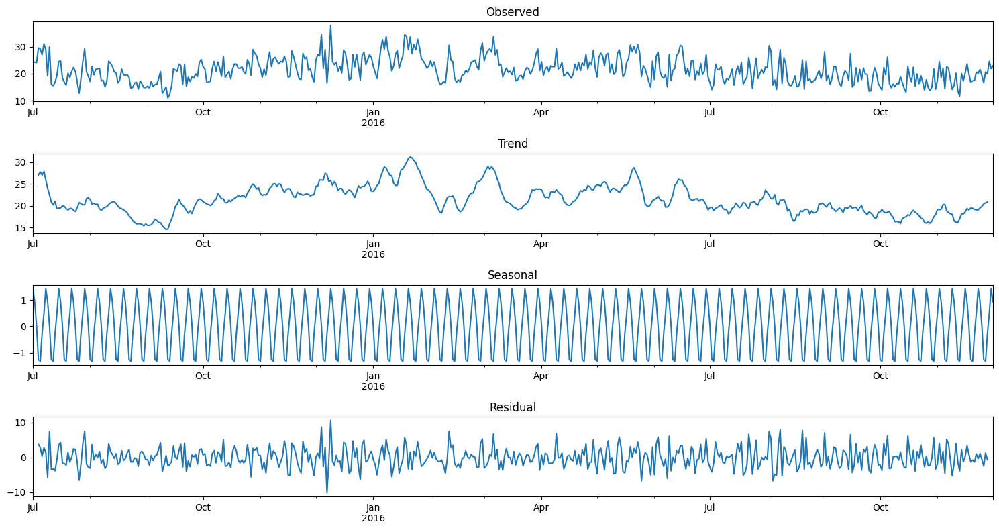


Plotting ACF and PACF...


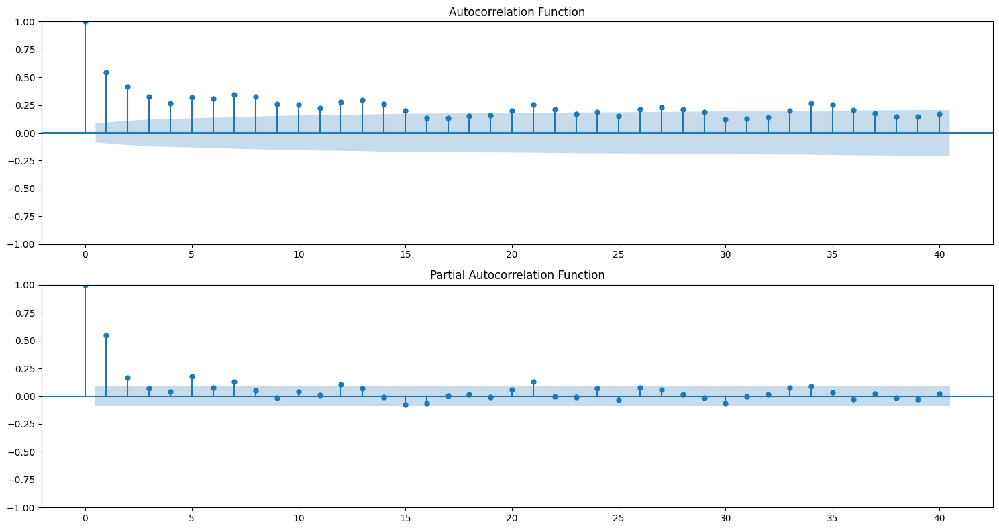

LANGUAGES: ru
Checking stationarity...
Checking stationarity by differencing 0 times
ADF Statistic: -1.896553
p-value: 0.333685
The time series is non-stationary.
Checking stationarity by differencing 1 times
ADF Statistic: -8.038057
p-value: 0.000000
The time series is stationary.

Decomposing the time series...


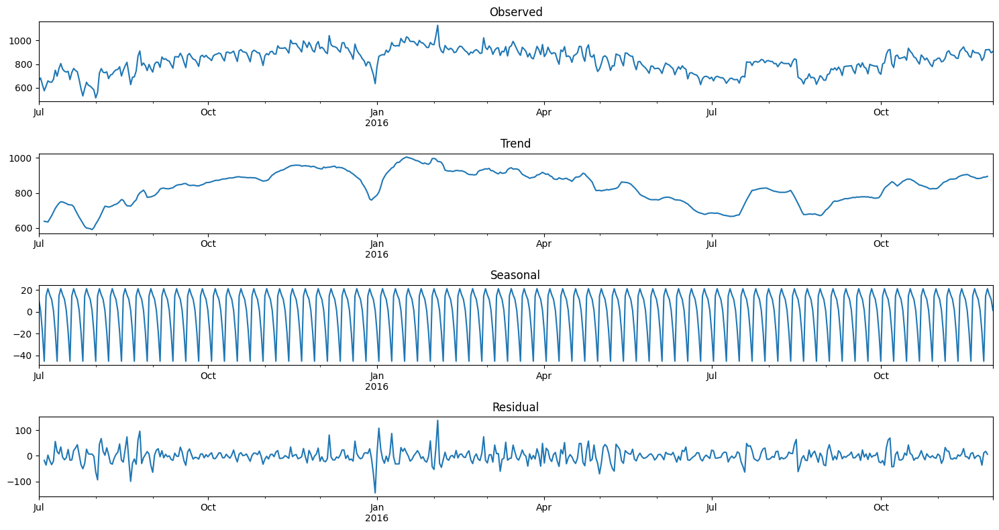


Plotting ACF and PACF...


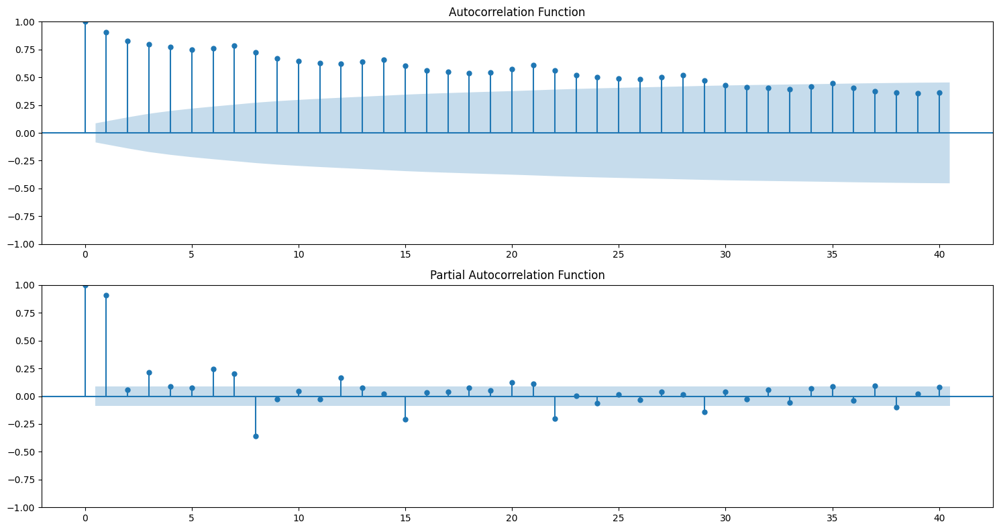

LANGUAGES: zh
Checking stationarity...
Checking stationarity by differencing 0 times
ADF Statistic: -2.212517
p-value: 0.201734
The time series is non-stationary.
Checking stationarity by differencing 1 times
ADF Statistic: -8.372289
p-value: 0.000000
The time series is stationary.

Decomposing the time series...


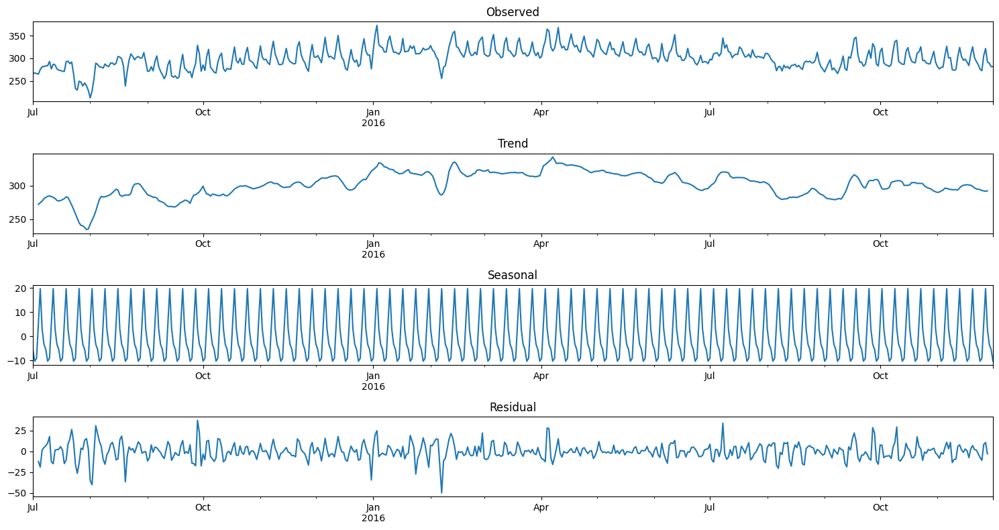


Plotting ACF and PACF...


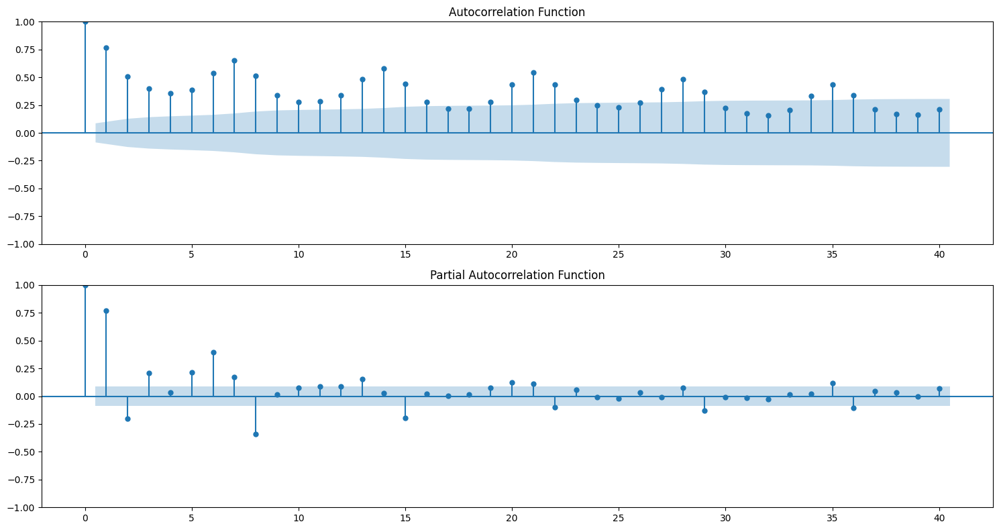

In [22]:
for ind in train_dataset2.index:
    print('===========================================')
    print('LANGUAGES: {}'.format(ind))
    print('===========================================')
    analyze_timeseries(train_dataset2.loc[ind], lags=40, model='additive')

In [23]:
#most seasonality observed here are weekly based (5/6/7 days)
#with additive model, errors are homoskedastic (no pattern with day)

In [24]:

#languages de,en,fr,ja,ru,zh -- mean page views across the timeline show stationarity after differencing once
#while languages es and other(languages<0.1% of dataset) are already stationary

LANGUAGE: de
Best SARIMA((1, 1, 0), (1, 1, 1, 7)) MAPE=0.018424212241424695


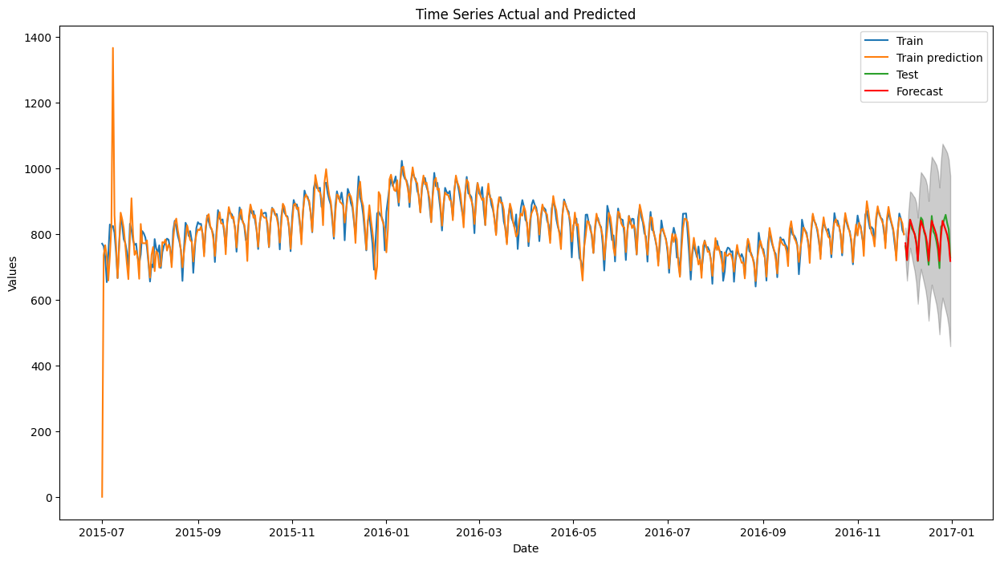

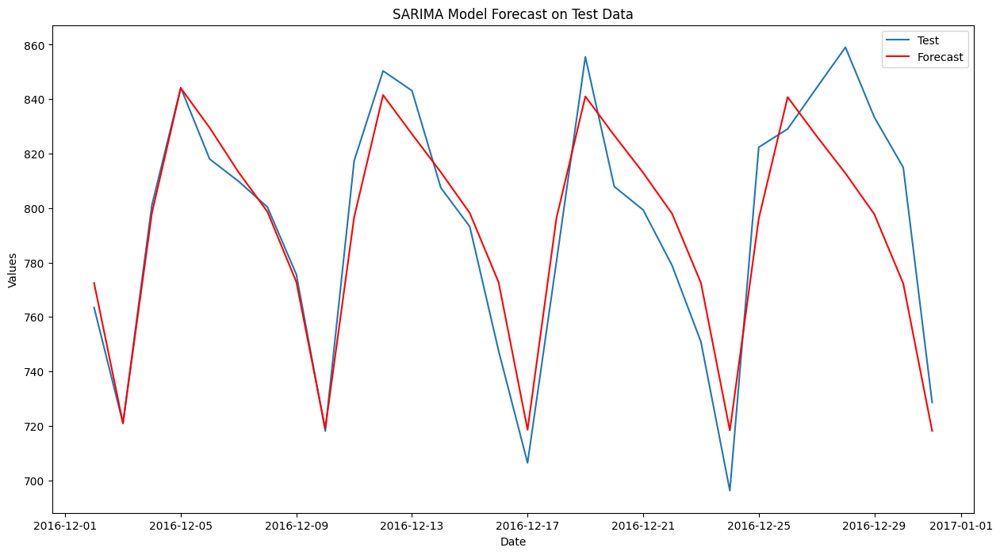

Train MAPE: 0.025075031103532725
Test MAPE: 0.018424212241424695
Train MSE: 2374.332947107072
Test MSE: 354.81693639735806
Train RMSE: 48.72712742515274
Test RMSE: 18.836585051366345
Train Residuals Diagnostics:


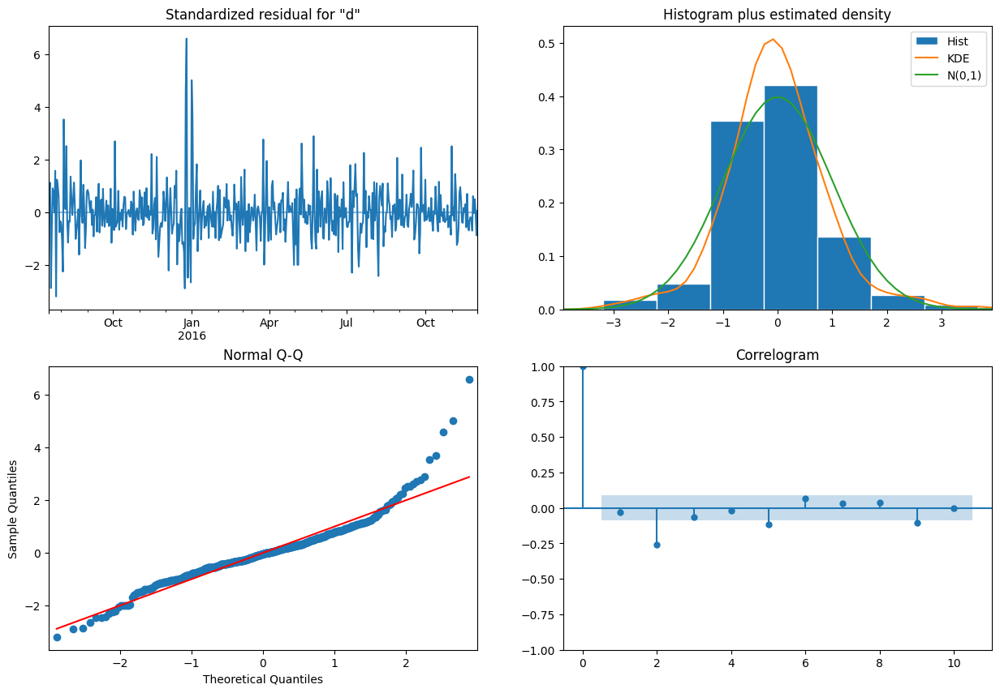

LANGUAGE: en
Best SARIMA((1, 0, 0), (1, 1, 1, 7)) MAPE=0.024877652587347778


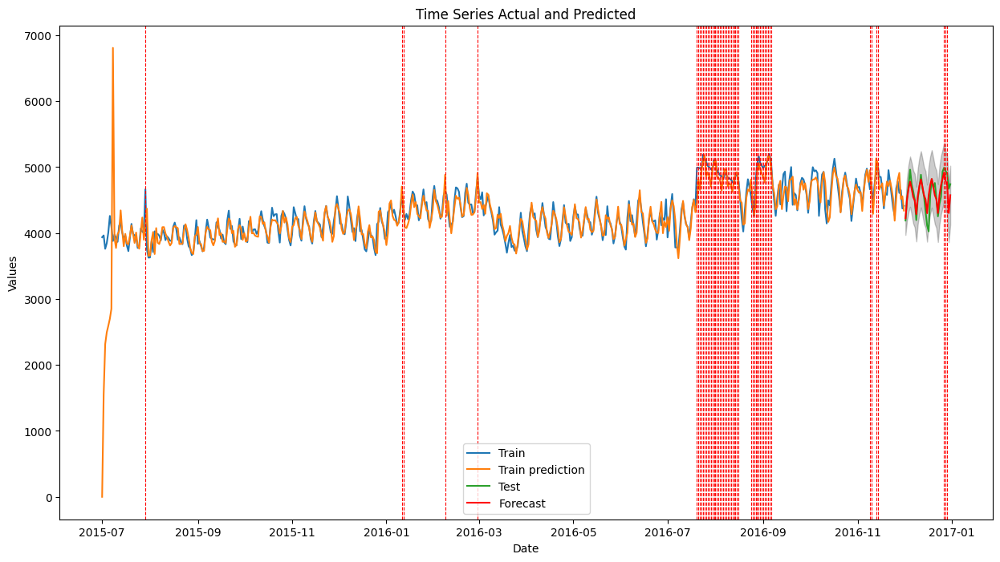

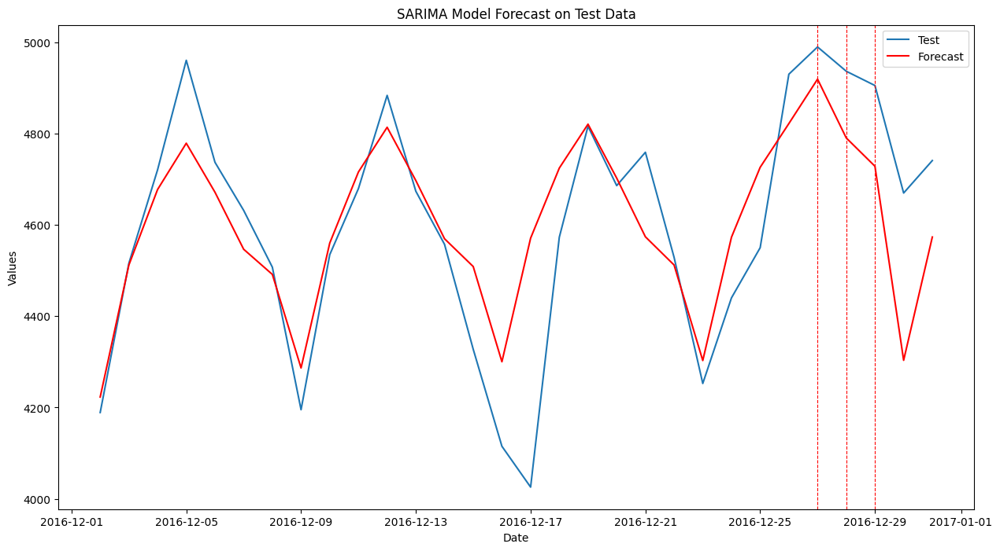

Train MAPE: 0.029663783734275903
Test MAPE: 0.024877652587347778
Train MSE: 93090.08928411185
Test MSE: 25641.835672454657
Train RMSE: 305.1066850859087
Test RMSE: 160.13068310743776
Train Residuals Diagnostics:


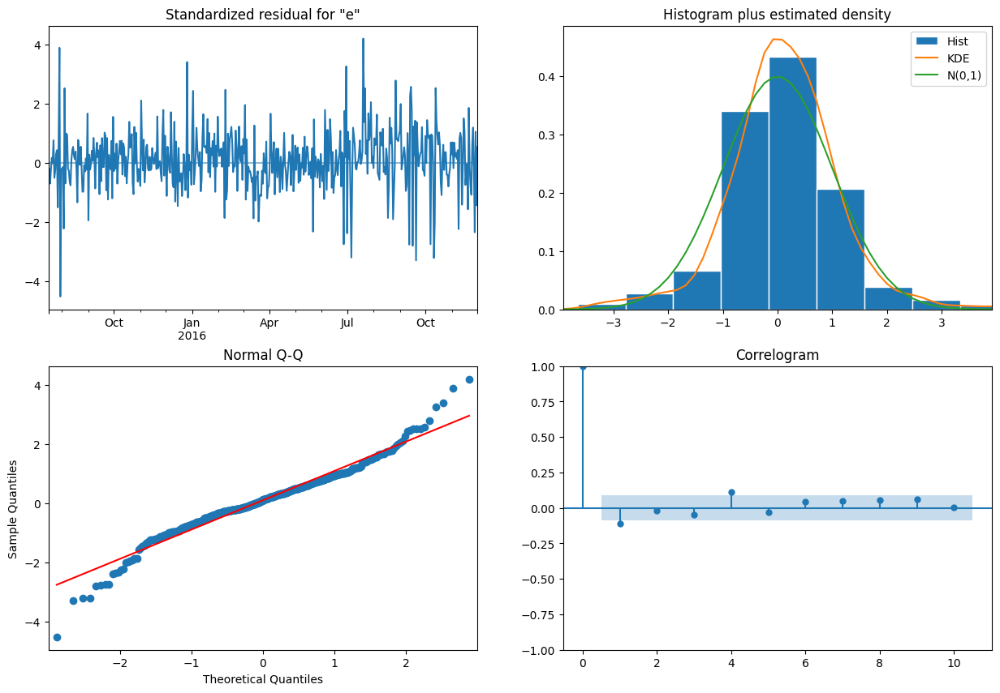

LANGUAGE: es
Best SARIMA((1, 0, 1), (0, 0, 1, 6)) MAPE=0.09965274800451698


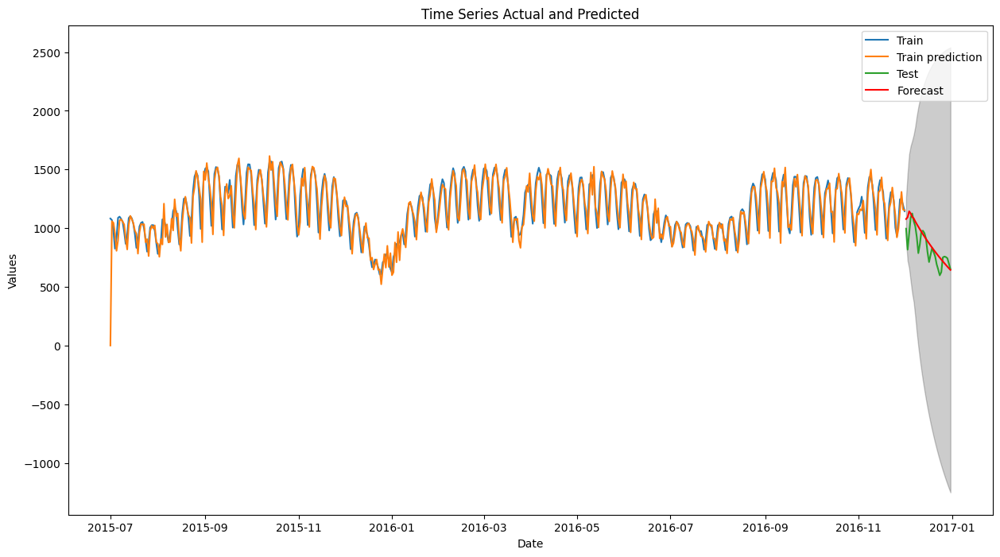

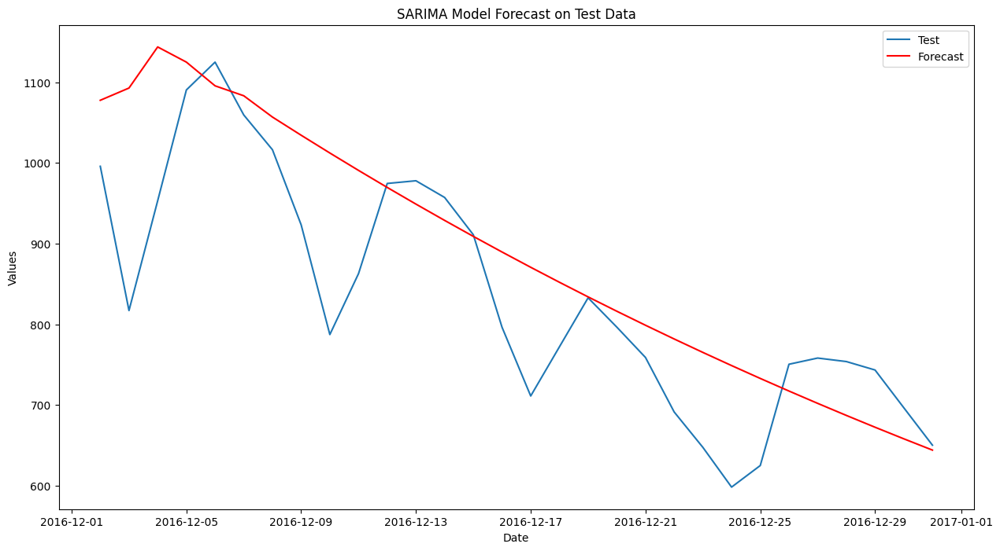

Train MAPE: 0.06877858529286501
Test MAPE: 0.09965274800451698
Train MSE: 10922.655052636088
Test MSE: 10622.28277291382
Train RMSE: 104.51150679535765
Test RMSE: 103.06445931024827
Train Residuals Diagnostics:


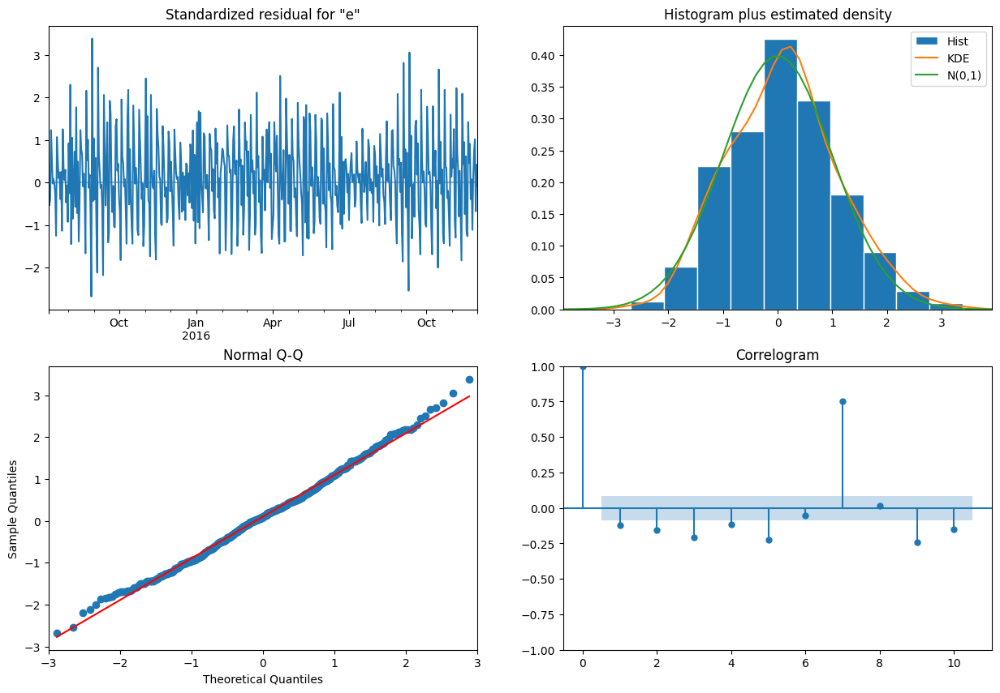

LANGUAGE: fr
Best SARIMA((1, 1, 1), (0, 1, 1, 7)) MAPE=0.025259699857725578


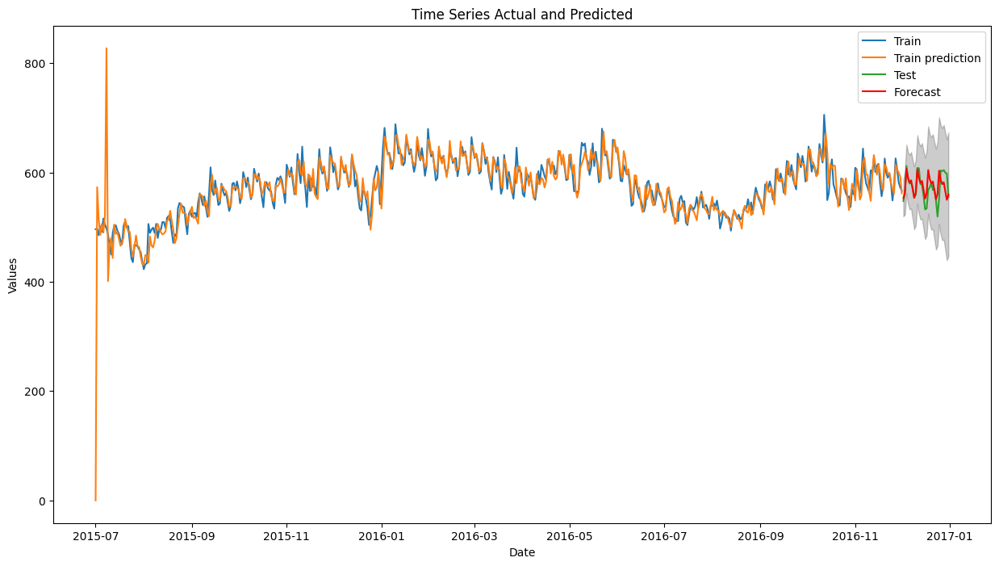

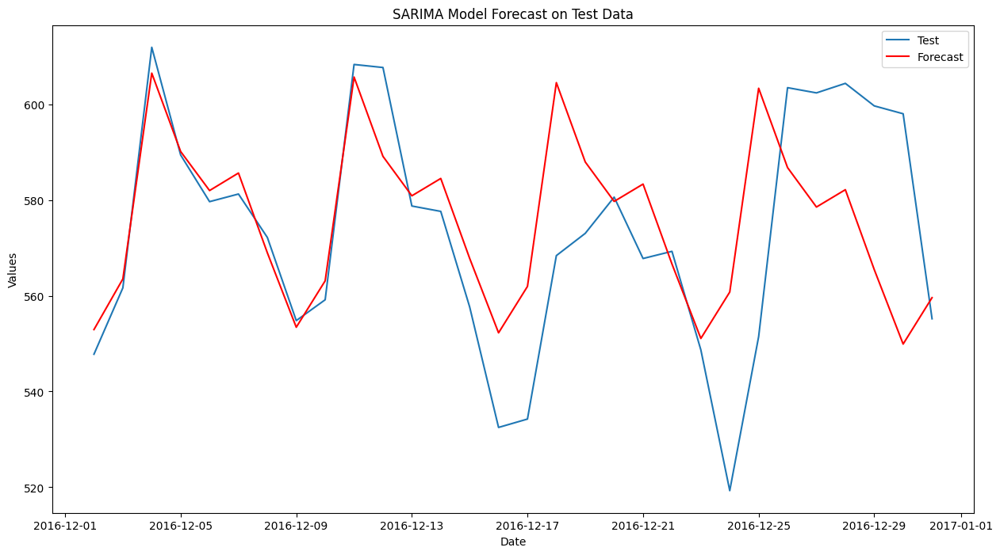

Train MAPE: 0.025436574123286797
Test MAPE: 0.025259699857725578
Train MSE: 1000.5627624371326
Test MSE: 426.9274248849908
Train RMSE: 31.63167340557772
Test RMSE: 20.66222216715789
Train Residuals Diagnostics:


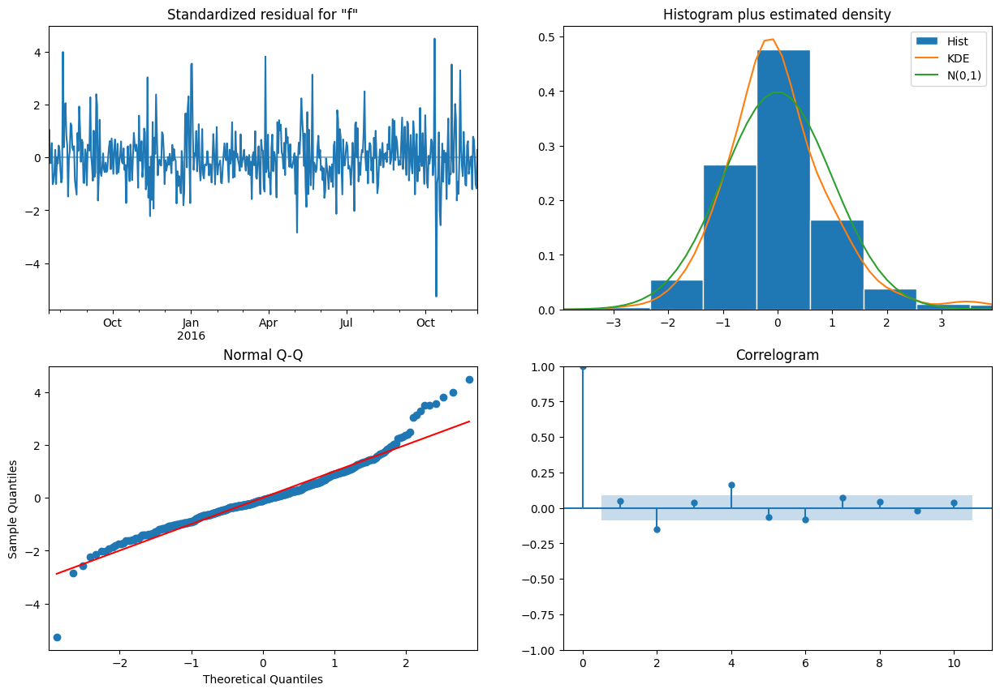

LANGUAGE: ja
Best SARIMA((0, 0, 0), (0, 1, 1, 7)) MAPE=0.02549359334678365


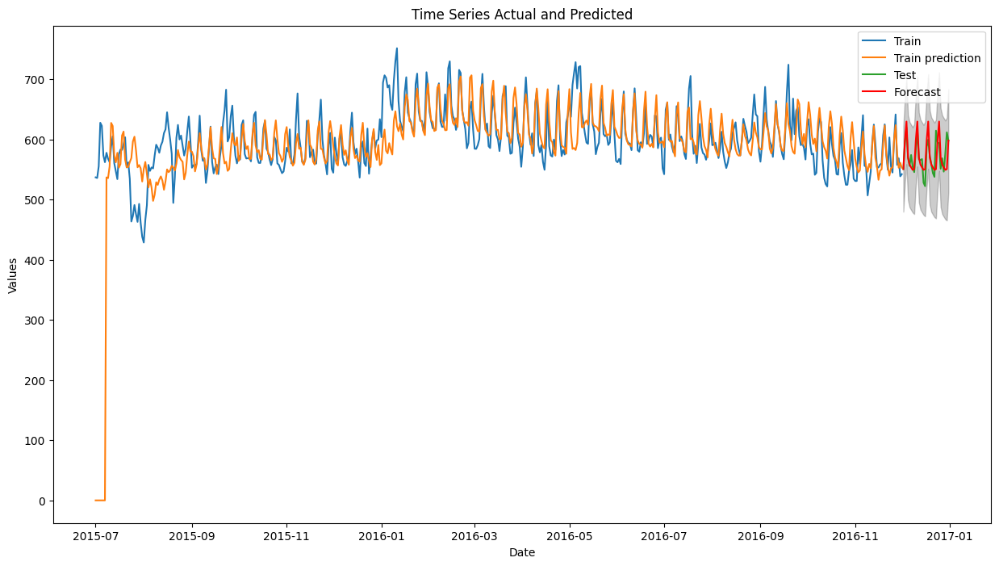

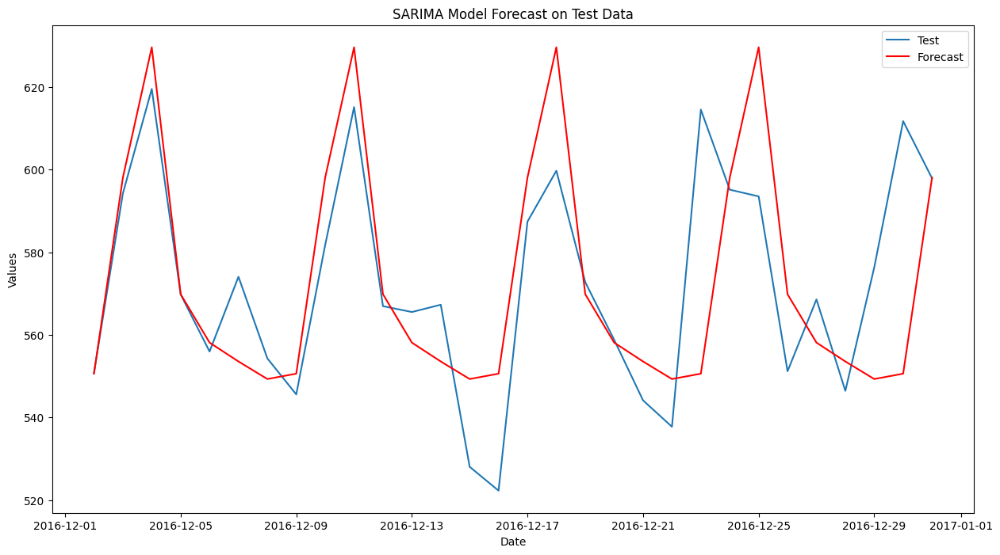

Train MAPE: 0.05606553903011358
Test MAPE: 0.02549359334678365
Train MSE: 5733.81166940124
Test MSE: 473.22104834539215
Train RMSE: 75.72193651380846
Test RMSE: 21.753644484209815
Train Residuals Diagnostics:


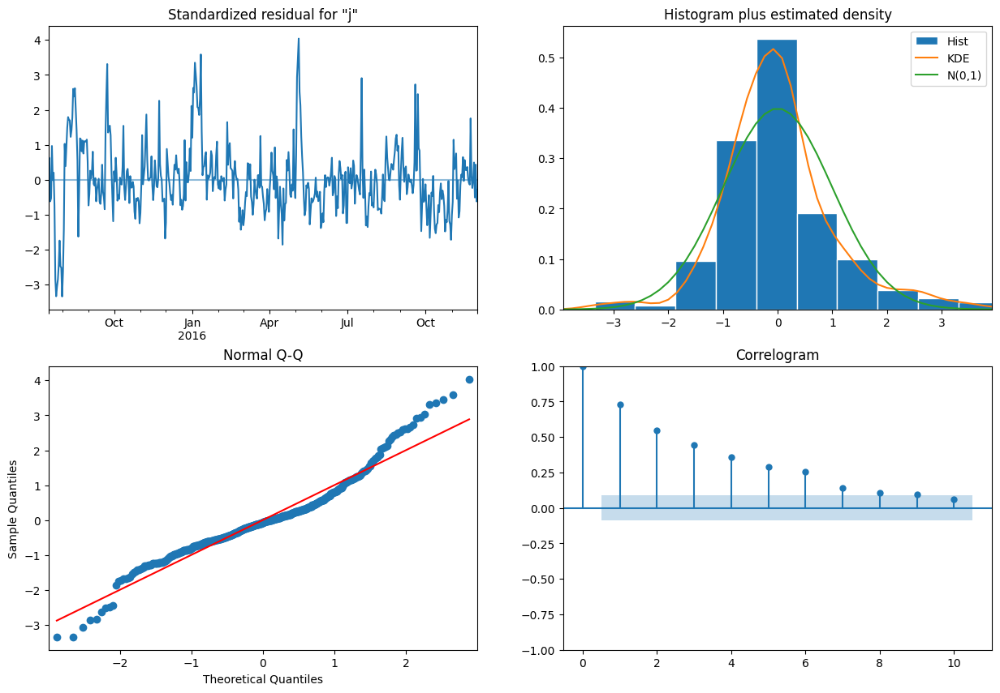

LANGUAGE: other
Best SARIMA((1, 0, 0), (1, 0, 1, 6)) MAPE=0.11282701119519985


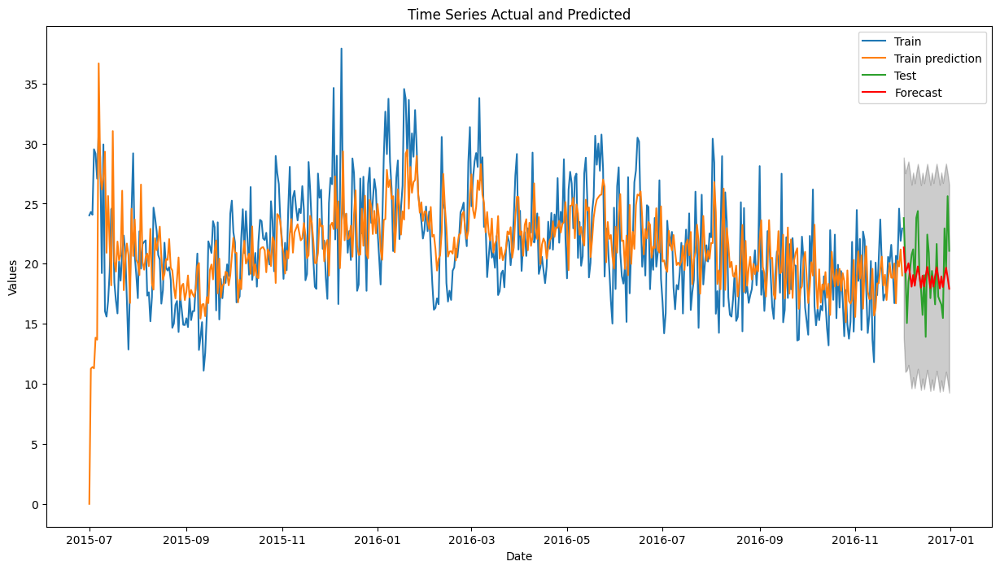

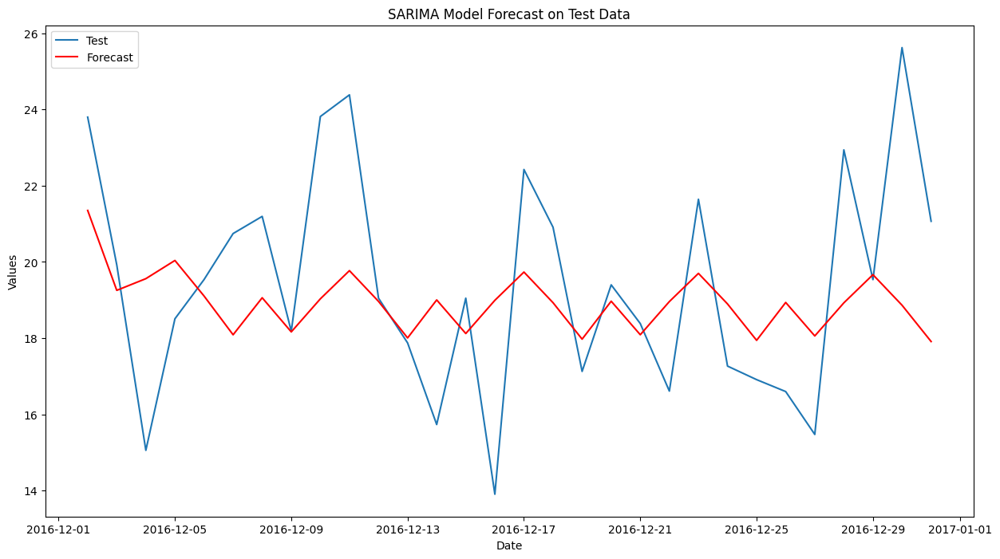

Train MAPE: 0.1566714599801324
Test MAPE: 0.11282701119519985
Train MSE: 18.116063575400677
Test MSE: 7.712599733632331
Train RMSE: 4.256296932240592
Test RMSE: 2.777156771525931
Train Residuals Diagnostics:


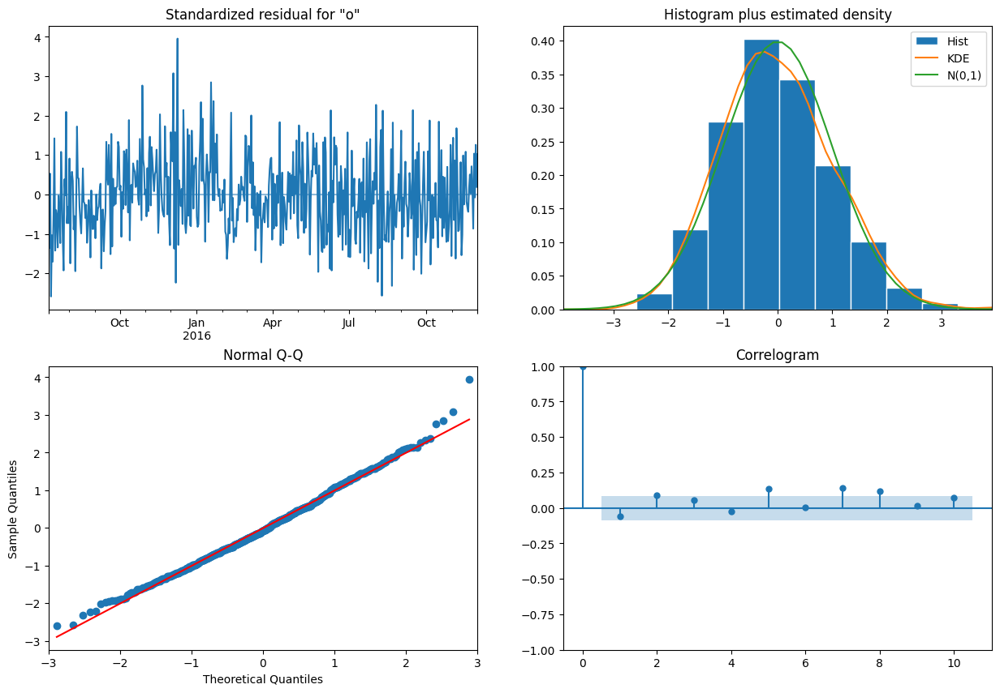

LANGUAGE: ru
Best SARIMA((1, 0, 1), (1, 0, 1, 7)) MAPE=0.050687046989295874


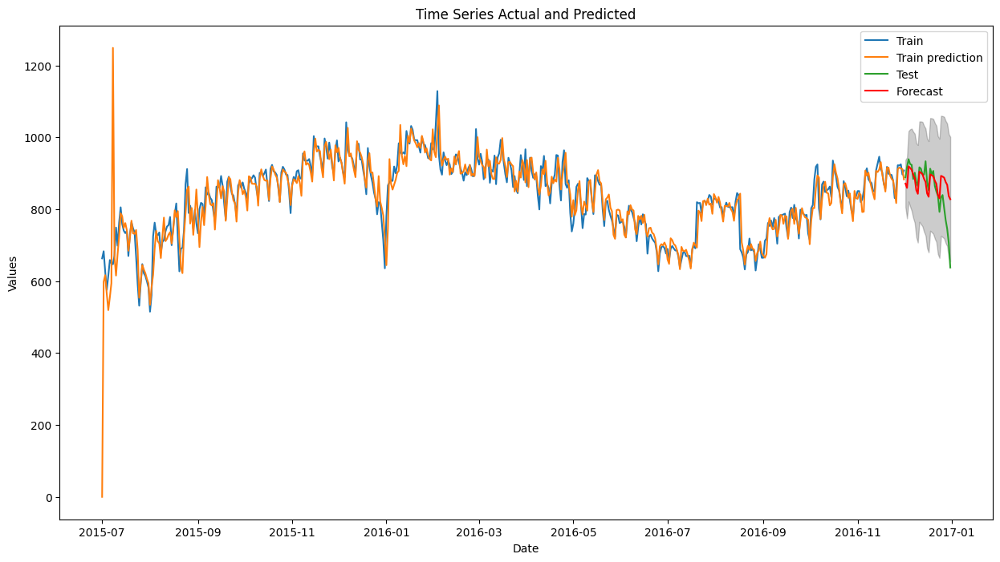

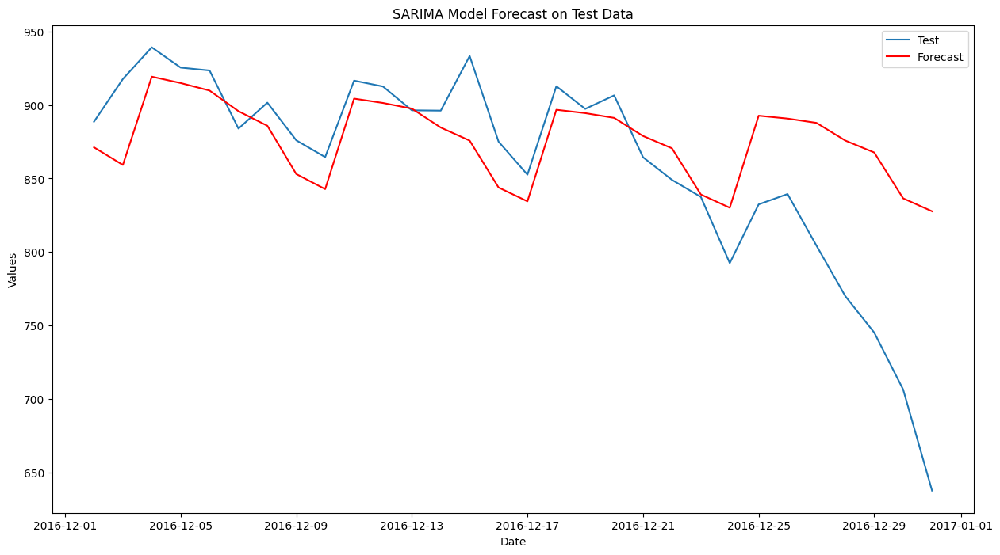

Train MAPE: 0.032995533947819025
Test MAPE: 0.050687046989295874
Train MSE: 2734.7364653245977
Test MSE: 3524.8745998795903
Train RMSE: 52.29470781374151
Test RMSE: 59.370654366274174
Train Residuals Diagnostics:


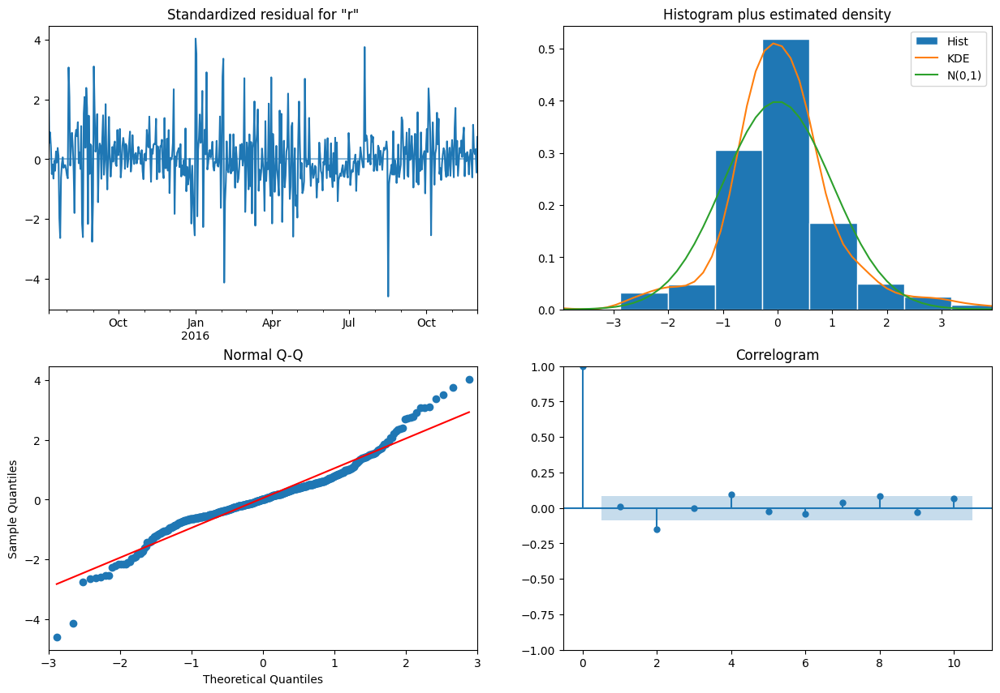

LANGUAGE: zh
Best SARIMA((0, 1, 1), (1, 0, 0, 7)) MAPE=0.02204455180924468


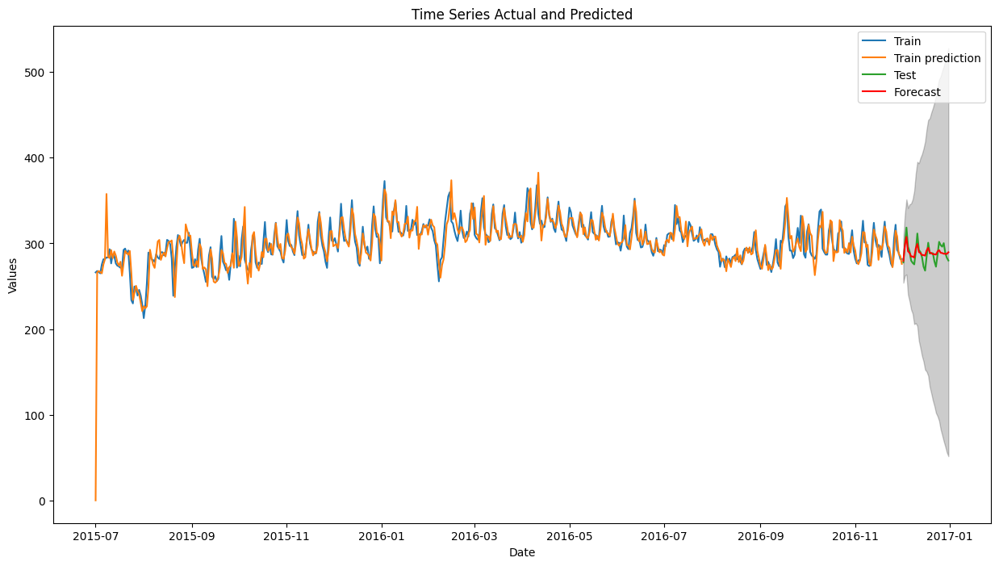

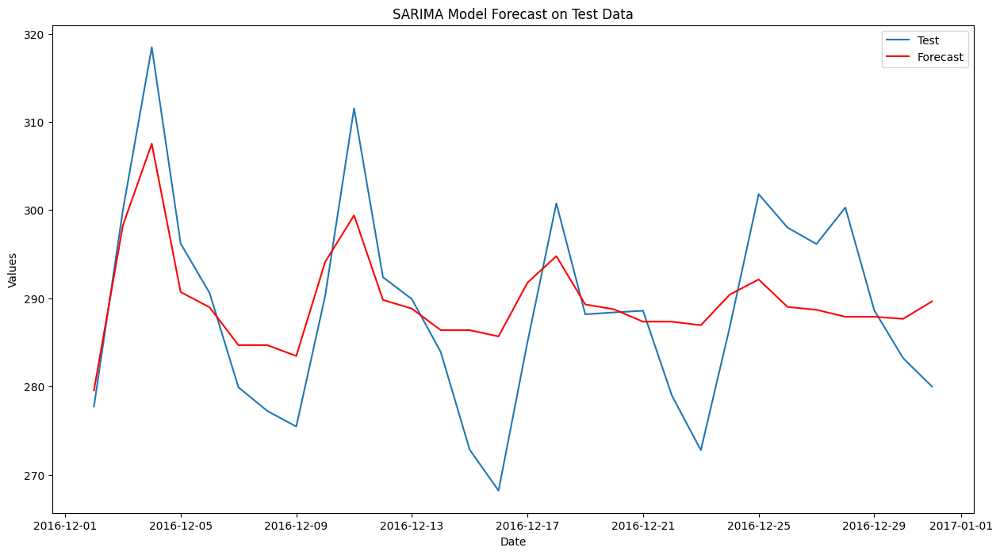

Train MAPE: 0.033342747419525996
Test MAPE: 0.02204455180924468
Train MSE: 314.2630190771335
Test MSE: 61.08368212085282
Train RMSE: 17.72746510579371
Test RMSE: 7.815605038693602
Train Residuals Diagnostics:


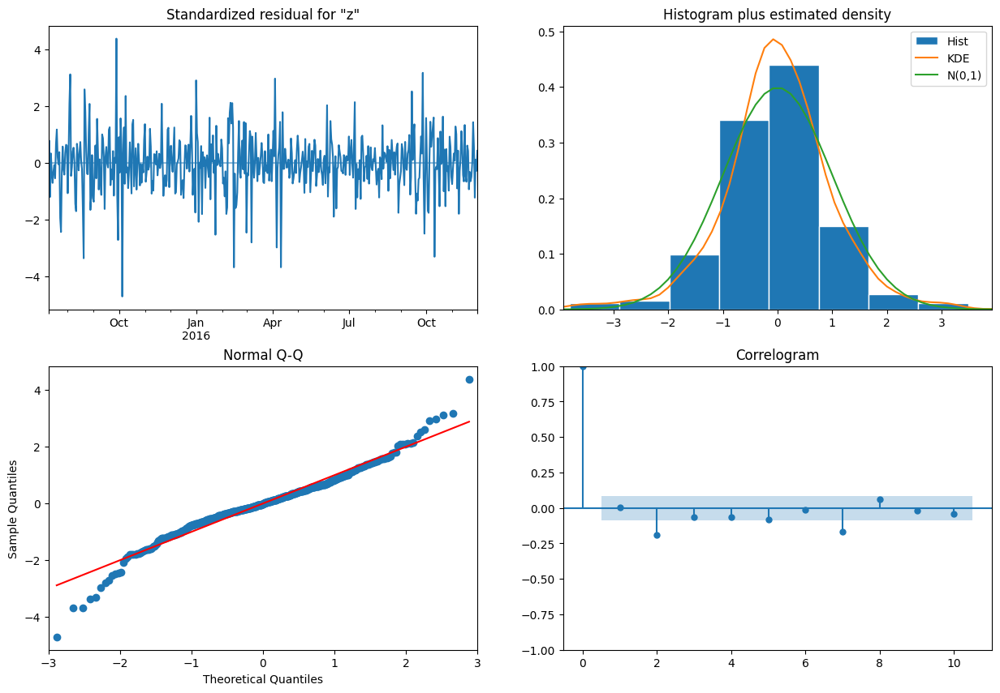

In [25]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_absolute_percentage_error as mape, mean_squared_error as mse
import itertools
import warnings
warnings.filterwarnings("ignore")

def sarima_grid_search(train, test,exog_d, p_values, d_values, q_values, P_values, D_values, Q_values, s_values):
    best_score, best_cfg = float("inf"), None
    best_model = None
    best_forecast = None
    best_ci = None

    pdq = list(itertools.product(p_values, d_values, q_values))
    seasonal_pdq = list(itertools.product(P_values, D_values, Q_values, s_values))
    
    for param in pdq:
        for param_seasonal in seasonal_pdq:
            try:
                model = SARIMAX(train, order=param, seasonal_order=param_seasonal, exog=exog_d.loc[train.index].Exog
                                , enforce_stationarity=False, enforce_invertibility=False)
                results = model.fit(disp=False)
                
                forecast_obj = results.get_forecast(steps=len(test), exog=exog_d.loc[test.index].Exog)
                forecast = forecast_obj.predicted_mean
                ci = forecast_obj.conf_int()
                
                error = mape(test, forecast)
                
                if error < best_score:
                    best_score, best_cfg = error, (param, param_seasonal)
                    best_model = results
                    best_forecast = forecast
                    best_ci = ci
                    
            except Exception as e:
                model = SARIMAX(train, order=param, seasonal_order=param_seasonal
                                , enforce_stationarity=False, enforce_invertibility=False)
                results = model.fit(disp=False)
                
                forecast_obj = results.get_forecast(steps=len(test))
                forecast = forecast_obj.predicted_mean
                ci = forecast_obj.conf_int()
                
                error = mape(test, forecast)
                
                if error < best_score:
                    best_score, best_cfg = error, (param, param_seasonal)
                    best_model = results
                    best_forecast = forecast
                    best_ci = ci
                
    print(f'Best SARIMA{best_cfg} MAPE={best_score}')
    return best_model, best_cfg, best_forecast,best_ci

def plot_forecast(best_model,train, test, forecast,ci,exog_d, title):
    plt.figure(figsize=(15, 8))
    plt.plot(train.index, train, label='Train')
    plt.plot(train.index,best_model.fittedvalues,label='Train prediction')
    plt.plot(test.index, test, label='Test')
    plt.plot(test.index, forecast, label='Forecast', color='red')
    plt.fill_between(test.index, ci.iloc[:, 0], ci.iloc[:, 1], color='k', alpha=0.2)
    try:
        for idx in exog_d.loc[exog_d['Exog'] == 1].index:
            plt.axvline(x=pd.to_datetime(idx), color='red', linestyle='--', linewidth=0.8)
    except:
        pass
    plt.title('Time Series Actual and Predicted')
    plt.xlabel('Date')
    plt.ylabel('Values')
    plt.legend()
    plt.show()
    
    plt.figure(figsize=(15, 8))
    plt.plot(test.index, test, label='Test')
    plt.plot(test.index, forecast, label='Forecast', color='red')
    try:
        for idx in exog_d.loc[(exog_d['Exog'] == 1)&(exog_d.index.isin(test.index))].index:
            plt.axvline(x=pd.to_datetime(idx), color='red', linestyle='--', linewidth=0.8)
    except:
        pass
    plt.title(title)
    plt.xlabel('Date')
    plt.ylabel('Values')
    plt.legend()
    plt.show()
    
    

def analyze_sarima(train, test,exog_d, p_values, d_values, q_values, P_values, D_values, Q_values, s_values):
    train.index=pd.to_datetime(train.index,errors='coerce')
    test.index=pd.to_datetime(test.index,errors='coerce')
    
    try:
        exog_d.index=pd.to_datetime(exog_d.index,errors='coerce')
    except:
        pass
    
    best_model, best_cfg, best_forecast,best_ci = sarima_grid_search(train, test,exog_d, p_values, d_values, q_values, P_values, D_values, Q_values, s_values)
    
    
    # Plot train, test, and forecast
    plot_forecast(best_model,train, test, best_forecast,best_ci,exog_d, 'SARIMA Model Forecast on Test Data')
    
    
    # Calculate MAPE for train and test data
    train_forecast = best_model.fittedvalues
    train_mape = mape(train, train_forecast)
    test_mape = mape(test, best_forecast)
    

    train_mse = mse(train, train_forecast)
    test_mse = mse(test, best_forecast)
    train_rmse = np.sqrt(train_mse)
    test_rmse = np.sqrt(test_mse)
    
    print(f'Train MAPE: {train_mape}')
    print(f'Test MAPE: {test_mape}')
    print(f'Train MSE: {train_mse}')
    print(f'Test MSE: {test_mse}')
    print(f'Train RMSE: {train_rmse}')
    print(f'Test RMSE: {test_rmse}')
    
    # Plot diagnostics of residuals
    print("Train Residuals Diagnostics:")
    best_model.plot_diagnostics(figsize=(15, 10))
    plt.show()

# Parameter ranges
p_values = q_values = P_values = Q_values = range(0, 2)
d_values=D_values=range(0,2)
s_values= range(5,8)
# Analyze SARIMA

for ind in train_dataset2.index:
    print('==================================================================')
    print('LANGUAGE: {}'.format(ind))
    if ind=='en':
        analyze_sarima(train_dataset2.loc[ind], test_dataset2.loc[ind],exog_d, p_values, d_values, q_values, P_values, D_values, Q_values, s_values)
    else:
        analyze_sarima(train_dataset2.loc[ind], test_dataset2.loc[ind],None, p_values, d_values, q_values, P_values, D_values, Q_values, s_values)





In [26]:
from prophet import Prophet
from sklearn.metrics import mean_absolute_percentage_error as mape, mean_squared_error as mse
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import logging

# Set logging level to WARNING to suppress INFO messages
logging.getLogger('fbprophet').setLevel(logging.WARNING)
# Suppress warnings
import warnings
warnings.filterwarnings("ignore")


def prophet_grid_search(train, test, param_grid):
    best_score, best_cfg = float("inf"), None
    best_model = None
    best_forecast = None
    
    for param in param_grid:
        try:
            # Initialize and fit the model
            model = Prophet(changepoint_prior_scale=param['changepoint_prior_scale'], 
                            seasonality_prior_scale=param['seasonality_prior_scale'])
            
            # Add external regressors if present
            if 'exog' in train.columns:
                model.add_regressor('exog')
            
            model.fit(train)
            
            # Make predictions
            future = test[['ds']].copy()
            
            if 'exog' in train.columns:
                future = test[['ds','exog']].copy()
            
            forecast = model.predict(future)
            
            # Calculate MAPE on the test set
            error = mape(test['y'], forecast['yhat'][-len(test):])
            
            if error < best_score:
                best_score, best_cfg = error, param
                best_model = model
                best_forecast = forecast['yhat'][-len(test):]
                
        except Exception as e:
            continue
    
    print(f'Best Prophet config: {best_cfg} MAPE={best_score}')
    return best_model, best_cfg, best_forecast


def plot_forecast(best_model, train, test, forecast, title):
    plt.figure(figsize=(15, 8))
    
    #print(test,forecast)
    plt.plot(train['ds'], train['y'], label='Train')
    plt.plot(test['ds'], test['y'], label='Test')
    plt.plot(test['ds'], forecast, label='Forecast', color='red')
    
    # If changepoints exist, plot them
    try:
        for idx in best_model.changepoints:
            plt.axvline(x=pd.to_datetime(idx), color='red', linestyle='--', linewidth=0.8)
    except:
        pass
    
    try:
        for idx in train.loc[(train['exog'] == 1)].index:
            plt.axvline(x=pd.to_datetime(idx), color='green', linestyle='--', linewidth=0.8)
        for idx in test.loc[(test['exog'] == 1)].index:
            plt.axvline(x=pd.to_datetime(idx), color='green', linestyle='--', linewidth=0.8)
    except:
        pass
    
    plt.title(title)
    plt.xlabel('Date')
    plt.ylabel('Values')
    plt.legend()
    plt.show()

16:43:24 - cmdstanpy - INFO - Chain [1] start processing


LANGUAGE: de


16:43:24 - cmdstanpy - INFO - Chain [1] done processing
16:43:24 - cmdstanpy - INFO - Chain [1] start processing
16:43:24 - cmdstanpy - INFO - Chain [1] done processing
16:43:24 - cmdstanpy - INFO - Chain [1] start processing
16:43:24 - cmdstanpy - INFO - Chain [1] done processing
16:43:24 - cmdstanpy - INFO - Chain [1] start processing
16:43:25 - cmdstanpy - INFO - Chain [1] done processing
16:43:25 - cmdstanpy - INFO - Chain [1] start processing
16:43:25 - cmdstanpy - INFO - Chain [1] done processing
16:43:25 - cmdstanpy - INFO - Chain [1] start processing
16:43:25 - cmdstanpy - INFO - Chain [1] done processing
16:43:25 - cmdstanpy - INFO - Chain [1] start processing
16:43:25 - cmdstanpy - INFO - Chain [1] done processing
16:43:25 - cmdstanpy - INFO - Chain [1] start processing
16:43:25 - cmdstanpy - INFO - Chain [1] done processing
16:43:25 - cmdstanpy - INFO - Chain [1] start processing
16:43:26 - cmdstanpy - INFO - Chain [1] done processing
16:43:26 - cmdstanpy - INFO - Chain [1] 

16:43:37 - cmdstanpy - INFO - Chain [1] done processing
16:43:38 - cmdstanpy - INFO - Chain [1] start processing
16:43:38 - cmdstanpy - INFO - Chain [1] done processing
16:43:38 - cmdstanpy - INFO - Chain [1] start processing
16:43:38 - cmdstanpy - INFO - Chain [1] done processing
16:43:38 - cmdstanpy - INFO - Chain [1] start processing
16:43:38 - cmdstanpy - INFO - Chain [1] done processing
16:43:38 - cmdstanpy - INFO - Chain [1] start processing
16:43:38 - cmdstanpy - INFO - Chain [1] done processing
16:43:38 - cmdstanpy - INFO - Chain [1] start processing
16:43:39 - cmdstanpy - INFO - Chain [1] done processing
16:43:39 - cmdstanpy - INFO - Chain [1] start processing
16:43:39 - cmdstanpy - INFO - Chain [1] done processing
16:43:39 - cmdstanpy - INFO - Chain [1] start processing
16:43:39 - cmdstanpy - INFO - Chain [1] done processing
16:43:39 - cmdstanpy - INFO - Chain [1] start processing
16:43:39 - cmdstanpy - INFO - Chain [1] done processing
16:43:40 - cmdstanpy - INFO - Chain [1] 

16:43:54 - cmdstanpy - INFO - Chain [1] done processing
16:43:54 - cmdstanpy - INFO - Chain [1] start processing
16:43:54 - cmdstanpy - INFO - Chain [1] done processing
16:43:55 - cmdstanpy - INFO - Chain [1] start processing
16:43:55 - cmdstanpy - INFO - Chain [1] done processing
16:43:55 - cmdstanpy - INFO - Chain [1] start processing
16:43:55 - cmdstanpy - INFO - Chain [1] done processing
16:43:55 - cmdstanpy - INFO - Chain [1] start processing
16:43:55 - cmdstanpy - INFO - Chain [1] done processing
16:43:55 - cmdstanpy - INFO - Chain [1] start processing
16:43:55 - cmdstanpy - INFO - Chain [1] done processing
16:43:55 - cmdstanpy - INFO - Chain [1] start processing
16:43:56 - cmdstanpy - INFO - Chain [1] done processing
16:43:56 - cmdstanpy - INFO - Chain [1] start processing
16:43:56 - cmdstanpy - INFO - Chain [1] done processing
16:43:56 - cmdstanpy - INFO - Chain [1] start processing
16:43:56 - cmdstanpy - INFO - Chain [1] done processing
16:43:56 - cmdstanpy - INFO - Chain [1] 

Best Prophet config: {'changepoint_prior_scale': 0.05, 'seasonality_prior_scale': 0.5000000000000001} MAPE=0.06660452454342121


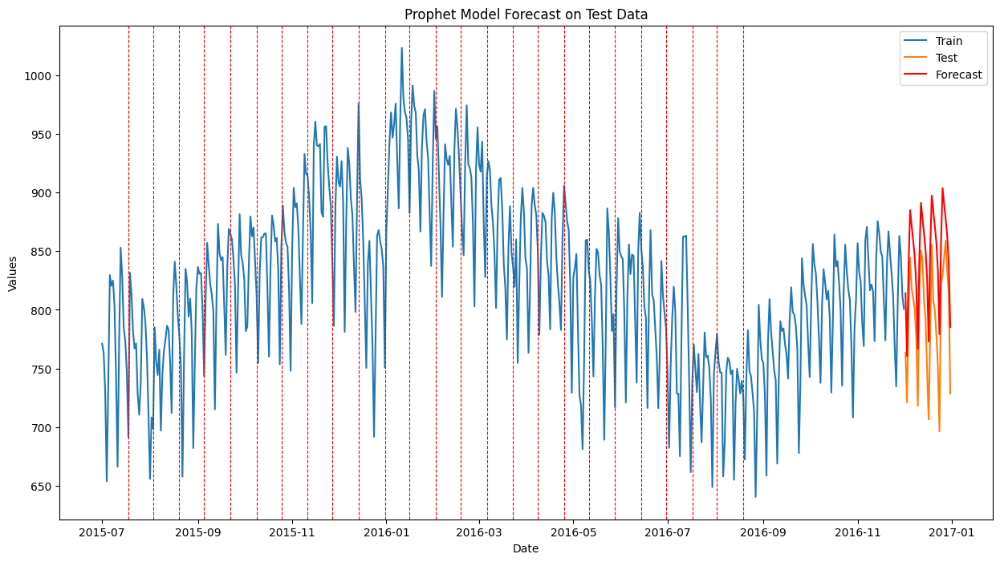

16:44:05 - cmdstanpy - INFO - Chain [1] start processing
16:44:05 - cmdstanpy - INFO - Chain [1] done processing


Train MAPE: 0.026687725547676122
Test MAPE: 0.06660452454342121
Train MSE: 961.0404640190795
Test MSE: 3047.387577673964
Train RMSE: 31.00065263859907
Test RMSE: 55.203148258717675
LANGUAGE: en


16:44:05 - cmdstanpy - INFO - Chain [1] start processing
16:44:05 - cmdstanpy - INFO - Chain [1] done processing
16:44:05 - cmdstanpy - INFO - Chain [1] start processing
16:44:05 - cmdstanpy - INFO - Chain [1] done processing
16:44:05 - cmdstanpy - INFO - Chain [1] start processing
16:44:05 - cmdstanpy - INFO - Chain [1] done processing
16:44:05 - cmdstanpy - INFO - Chain [1] start processing
16:44:06 - cmdstanpy - INFO - Chain [1] done processing
16:44:06 - cmdstanpy - INFO - Chain [1] start processing
16:44:06 - cmdstanpy - INFO - Chain [1] done processing
16:44:06 - cmdstanpy - INFO - Chain [1] start processing
16:44:06 - cmdstanpy - INFO - Chain [1] done processing
16:44:06 - cmdstanpy - INFO - Chain [1] start processing
16:44:06 - cmdstanpy - INFO - Chain [1] done processing
16:44:06 - cmdstanpy - INFO - Chain [1] start processing
16:44:06 - cmdstanpy - INFO - Chain [1] done processing
16:44:06 - cmdstanpy - INFO - Chain [1] start processing
16:44:06 - cmdstanpy - INFO - Chain [1]

16:44:18 - cmdstanpy - INFO - Chain [1] done processing
16:44:18 - cmdstanpy - INFO - Chain [1] start processing
16:44:18 - cmdstanpy - INFO - Chain [1] done processing
16:44:19 - cmdstanpy - INFO - Chain [1] start processing
16:44:19 - cmdstanpy - INFO - Chain [1] done processing
16:44:19 - cmdstanpy - INFO - Chain [1] start processing
16:44:19 - cmdstanpy - INFO - Chain [1] done processing
16:44:19 - cmdstanpy - INFO - Chain [1] start processing
16:44:19 - cmdstanpy - INFO - Chain [1] done processing
16:44:19 - cmdstanpy - INFO - Chain [1] start processing
16:44:19 - cmdstanpy - INFO - Chain [1] done processing
16:44:19 - cmdstanpy - INFO - Chain [1] start processing
16:44:19 - cmdstanpy - INFO - Chain [1] done processing
16:44:20 - cmdstanpy - INFO - Chain [1] start processing
16:44:20 - cmdstanpy - INFO - Chain [1] done processing
16:44:20 - cmdstanpy - INFO - Chain [1] start processing
16:44:20 - cmdstanpy - INFO - Chain [1] done processing
16:44:20 - cmdstanpy - INFO - Chain [1] 

16:44:34 - cmdstanpy - INFO - Chain [1] done processing
16:44:34 - cmdstanpy - INFO - Chain [1] start processing
16:44:34 - cmdstanpy - INFO - Chain [1] done processing
16:44:35 - cmdstanpy - INFO - Chain [1] start processing
16:44:35 - cmdstanpy - INFO - Chain [1] done processing
16:44:35 - cmdstanpy - INFO - Chain [1] start processing
16:44:35 - cmdstanpy - INFO - Chain [1] done processing
16:44:35 - cmdstanpy - INFO - Chain [1] start processing
16:44:35 - cmdstanpy - INFO - Chain [1] done processing
16:44:35 - cmdstanpy - INFO - Chain [1] start processing
16:44:35 - cmdstanpy - INFO - Chain [1] done processing
16:44:35 - cmdstanpy - INFO - Chain [1] start processing
16:44:36 - cmdstanpy - INFO - Chain [1] done processing
16:44:36 - cmdstanpy - INFO - Chain [1] start processing
16:44:36 - cmdstanpy - INFO - Chain [1] done processing
16:44:36 - cmdstanpy - INFO - Chain [1] start processing
16:44:36 - cmdstanpy - INFO - Chain [1] done processing
16:44:36 - cmdstanpy - INFO - Chain [1] 

Best Prophet config: {'changepoint_prior_scale': 0.35000000000000003, 'seasonality_prior_scale': 0.6000000000000002} MAPE=0.029284692339354063


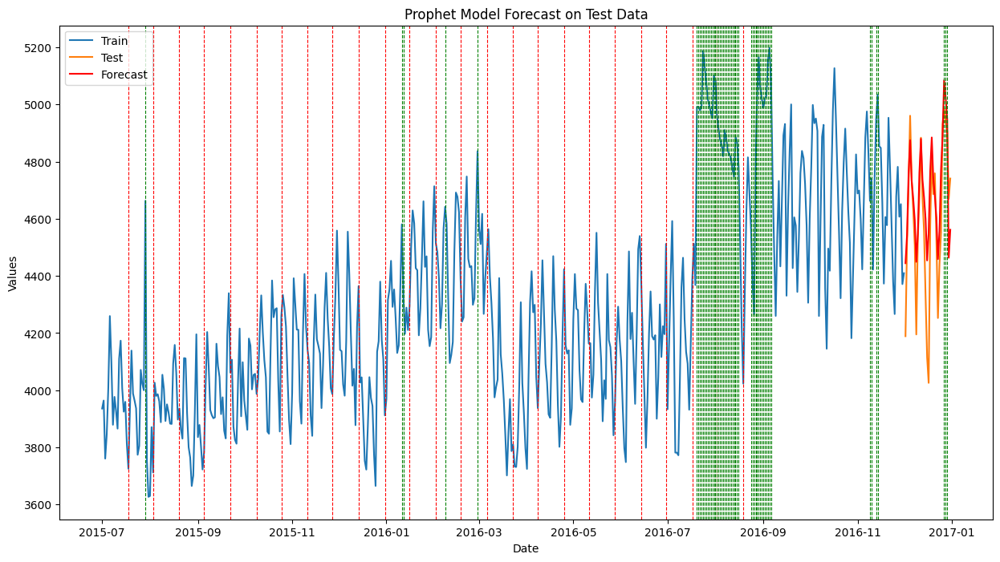

16:44:46 - cmdstanpy - INFO - Chain [1] start processing
16:44:46 - cmdstanpy - INFO - Chain [1] done processing


Train MAPE: 0.02453085979797113
Test MAPE: 0.029284692339354063
Train MSE: 19621.395918446284
Test MSE: 29892.32984087826
Train RMSE: 140.07639315190224
Test RMSE: 172.89398439760205
LANGUAGE: es


16:44:46 - cmdstanpy - INFO - Chain [1] start processing
16:44:46 - cmdstanpy - INFO - Chain [1] done processing
16:44:46 - cmdstanpy - INFO - Chain [1] start processing
16:44:46 - cmdstanpy - INFO - Chain [1] done processing
16:44:46 - cmdstanpy - INFO - Chain [1] start processing
16:44:46 - cmdstanpy - INFO - Chain [1] done processing
16:44:46 - cmdstanpy - INFO - Chain [1] start processing
16:44:46 - cmdstanpy - INFO - Chain [1] done processing
16:44:46 - cmdstanpy - INFO - Chain [1] start processing
16:44:46 - cmdstanpy - INFO - Chain [1] done processing
16:44:47 - cmdstanpy - INFO - Chain [1] start processing
16:44:47 - cmdstanpy - INFO - Chain [1] done processing
16:44:47 - cmdstanpy - INFO - Chain [1] start processing
16:44:47 - cmdstanpy - INFO - Chain [1] done processing
16:44:47 - cmdstanpy - INFO - Chain [1] start processing
16:44:47 - cmdstanpy - INFO - Chain [1] done processing
16:44:47 - cmdstanpy - INFO - Chain [1] start processing
16:44:47 - cmdstanpy - INFO - Chain [1]

16:44:58 - cmdstanpy - INFO - Chain [1] done processing
16:44:58 - cmdstanpy - INFO - Chain [1] start processing
16:44:58 - cmdstanpy - INFO - Chain [1] done processing
16:44:59 - cmdstanpy - INFO - Chain [1] start processing
16:44:59 - cmdstanpy - INFO - Chain [1] done processing
16:44:59 - cmdstanpy - INFO - Chain [1] start processing
16:44:59 - cmdstanpy - INFO - Chain [1] done processing
16:44:59 - cmdstanpy - INFO - Chain [1] start processing
16:44:59 - cmdstanpy - INFO - Chain [1] done processing
16:44:59 - cmdstanpy - INFO - Chain [1] start processing
16:44:59 - cmdstanpy - INFO - Chain [1] done processing
16:44:59 - cmdstanpy - INFO - Chain [1] start processing
16:44:59 - cmdstanpy - INFO - Chain [1] done processing
16:45:00 - cmdstanpy - INFO - Chain [1] start processing
16:45:00 - cmdstanpy - INFO - Chain [1] done processing
16:45:00 - cmdstanpy - INFO - Chain [1] start processing
16:45:00 - cmdstanpy - INFO - Chain [1] done processing
16:45:00 - cmdstanpy - INFO - Chain [1] 

16:45:14 - cmdstanpy - INFO - Chain [1] done processing
16:45:14 - cmdstanpy - INFO - Chain [1] start processing
16:45:14 - cmdstanpy - INFO - Chain [1] done processing
16:45:14 - cmdstanpy - INFO - Chain [1] start processing
16:45:15 - cmdstanpy - INFO - Chain [1] done processing
16:45:15 - cmdstanpy - INFO - Chain [1] start processing
16:45:15 - cmdstanpy - INFO - Chain [1] done processing
16:45:15 - cmdstanpy - INFO - Chain [1] start processing
16:45:15 - cmdstanpy - INFO - Chain [1] done processing
16:45:15 - cmdstanpy - INFO - Chain [1] start processing
16:45:15 - cmdstanpy - INFO - Chain [1] done processing
16:45:15 - cmdstanpy - INFO - Chain [1] start processing
16:45:16 - cmdstanpy - INFO - Chain [1] done processing
16:45:16 - cmdstanpy - INFO - Chain [1] start processing
16:45:16 - cmdstanpy - INFO - Chain [1] done processing
16:45:16 - cmdstanpy - INFO - Chain [1] start processing
16:45:16 - cmdstanpy - INFO - Chain [1] done processing
16:45:16 - cmdstanpy - INFO - Chain [1] 

Best Prophet config: {'changepoint_prior_scale': 0.5, 'seasonality_prior_scale': 0.25000000000000006} MAPE=0.45970992064362554


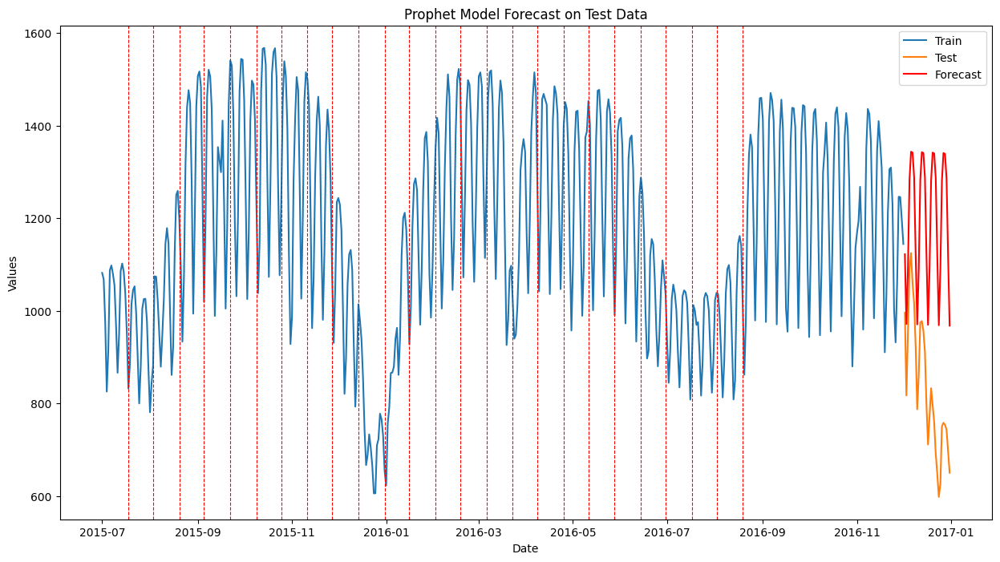

16:45:25 - cmdstanpy - INFO - Chain [1] start processing
16:45:25 - cmdstanpy - INFO - Chain [1] done processing


Train MAPE: 0.05166069821369039
Test MAPE: 0.45970992064362554
Train MSE: 5272.977055024213
Test MSE: 150670.36007339452
Train RMSE: 72.61526736867539
Test RMSE: 388.16280099127806
LANGUAGE: fr


16:45:25 - cmdstanpy - INFO - Chain [1] start processing
16:45:25 - cmdstanpy - INFO - Chain [1] done processing
16:45:25 - cmdstanpy - INFO - Chain [1] start processing
16:45:25 - cmdstanpy - INFO - Chain [1] done processing
16:45:25 - cmdstanpy - INFO - Chain [1] start processing
16:45:25 - cmdstanpy - INFO - Chain [1] done processing
16:45:25 - cmdstanpy - INFO - Chain [1] start processing
16:45:26 - cmdstanpy - INFO - Chain [1] done processing
16:45:26 - cmdstanpy - INFO - Chain [1] start processing
16:45:26 - cmdstanpy - INFO - Chain [1] done processing
16:45:26 - cmdstanpy - INFO - Chain [1] start processing
16:45:26 - cmdstanpy - INFO - Chain [1] done processing
16:45:26 - cmdstanpy - INFO - Chain [1] start processing
16:45:26 - cmdstanpy - INFO - Chain [1] done processing
16:45:26 - cmdstanpy - INFO - Chain [1] start processing
16:45:26 - cmdstanpy - INFO - Chain [1] done processing
16:45:26 - cmdstanpy - INFO - Chain [1] start processing
16:45:26 - cmdstanpy - INFO - Chain [1]

16:45:38 - cmdstanpy - INFO - Chain [1] done processing
16:45:38 - cmdstanpy - INFO - Chain [1] start processing
16:45:38 - cmdstanpy - INFO - Chain [1] done processing
16:45:38 - cmdstanpy - INFO - Chain [1] start processing
16:45:38 - cmdstanpy - INFO - Chain [1] done processing
16:45:38 - cmdstanpy - INFO - Chain [1] start processing
16:45:38 - cmdstanpy - INFO - Chain [1] done processing
16:45:38 - cmdstanpy - INFO - Chain [1] start processing
16:45:38 - cmdstanpy - INFO - Chain [1] done processing
16:45:39 - cmdstanpy - INFO - Chain [1] start processing
16:45:39 - cmdstanpy - INFO - Chain [1] done processing
16:45:39 - cmdstanpy - INFO - Chain [1] start processing
16:45:39 - cmdstanpy - INFO - Chain [1] done processing
16:45:39 - cmdstanpy - INFO - Chain [1] start processing
16:45:39 - cmdstanpy - INFO - Chain [1] done processing
16:45:39 - cmdstanpy - INFO - Chain [1] start processing
16:45:39 - cmdstanpy - INFO - Chain [1] done processing
16:45:39 - cmdstanpy - INFO - Chain [1] 

16:45:52 - cmdstanpy - INFO - Chain [1] done processing
16:45:52 - cmdstanpy - INFO - Chain [1] start processing
16:45:52 - cmdstanpy - INFO - Chain [1] done processing
16:45:52 - cmdstanpy - INFO - Chain [1] start processing
16:45:52 - cmdstanpy - INFO - Chain [1] done processing
16:45:52 - cmdstanpy - INFO - Chain [1] start processing
16:45:52 - cmdstanpy - INFO - Chain [1] done processing
16:45:53 - cmdstanpy - INFO - Chain [1] start processing
16:45:53 - cmdstanpy - INFO - Chain [1] done processing
16:45:53 - cmdstanpy - INFO - Chain [1] start processing
16:45:53 - cmdstanpy - INFO - Chain [1] done processing
16:45:53 - cmdstanpy - INFO - Chain [1] start processing
16:45:53 - cmdstanpy - INFO - Chain [1] done processing
16:45:53 - cmdstanpy - INFO - Chain [1] start processing
16:45:53 - cmdstanpy - INFO - Chain [1] done processing
16:45:53 - cmdstanpy - INFO - Chain [1] start processing
16:45:54 - cmdstanpy - INFO - Chain [1] done processing
16:45:54 - cmdstanpy - INFO - Chain [1] 

Best Prophet config: {'changepoint_prior_scale': 0.05, 'seasonality_prior_scale': 0.6000000000000002} MAPE=0.0696474400505814


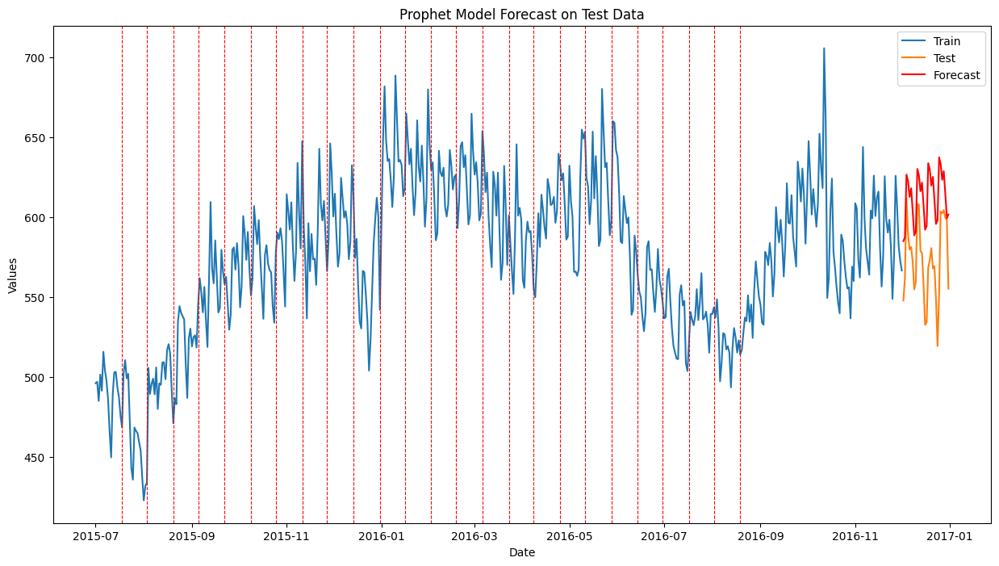

16:46:02 - cmdstanpy - INFO - Chain [1] start processing
16:46:02 - cmdstanpy - INFO - Chain [1] done processing


Train MAPE: 0.033920814634229524
Test MAPE: 0.0696474400505814
Train MSE: 635.3205194580602
Test MSE: 1892.5365997817592
Train RMSE: 25.20556524773964
Test RMSE: 43.50329412563788
LANGUAGE: ja


16:46:02 - cmdstanpy - INFO - Chain [1] start processing
16:46:02 - cmdstanpy - INFO - Chain [1] done processing
16:46:02 - cmdstanpy - INFO - Chain [1] start processing
16:46:02 - cmdstanpy - INFO - Chain [1] done processing
16:46:02 - cmdstanpy - INFO - Chain [1] start processing
16:46:02 - cmdstanpy - INFO - Chain [1] done processing
16:46:02 - cmdstanpy - INFO - Chain [1] start processing
16:46:02 - cmdstanpy - INFO - Chain [1] done processing
16:46:02 - cmdstanpy - INFO - Chain [1] start processing
16:46:02 - cmdstanpy - INFO - Chain [1] done processing
16:46:03 - cmdstanpy - INFO - Chain [1] start processing
16:46:03 - cmdstanpy - INFO - Chain [1] done processing
16:46:03 - cmdstanpy - INFO - Chain [1] start processing
16:46:03 - cmdstanpy - INFO - Chain [1] done processing
16:46:03 - cmdstanpy - INFO - Chain [1] start processing
16:46:03 - cmdstanpy - INFO - Chain [1] done processing
16:46:03 - cmdstanpy - INFO - Chain [1] start processing
16:46:03 - cmdstanpy - INFO - Chain [1]

16:46:13 - cmdstanpy - INFO - Chain [1] done processing
16:46:13 - cmdstanpy - INFO - Chain [1] start processing
16:46:14 - cmdstanpy - INFO - Chain [1] done processing
16:46:14 - cmdstanpy - INFO - Chain [1] start processing
16:46:14 - cmdstanpy - INFO - Chain [1] done processing
16:46:14 - cmdstanpy - INFO - Chain [1] start processing
16:46:14 - cmdstanpy - INFO - Chain [1] done processing
16:46:14 - cmdstanpy - INFO - Chain [1] start processing
16:46:14 - cmdstanpy - INFO - Chain [1] done processing
16:46:14 - cmdstanpy - INFO - Chain [1] start processing
16:46:14 - cmdstanpy - INFO - Chain [1] done processing
16:46:14 - cmdstanpy - INFO - Chain [1] start processing
16:46:14 - cmdstanpy - INFO - Chain [1] done processing
16:46:15 - cmdstanpy - INFO - Chain [1] start processing
16:46:15 - cmdstanpy - INFO - Chain [1] done processing
16:46:15 - cmdstanpy - INFO - Chain [1] start processing
16:46:15 - cmdstanpy - INFO - Chain [1] done processing
16:46:15 - cmdstanpy - INFO - Chain [1] 

16:46:28 - cmdstanpy - INFO - Chain [1] done processing
16:46:29 - cmdstanpy - INFO - Chain [1] start processing
16:46:29 - cmdstanpy - INFO - Chain [1] done processing
16:46:29 - cmdstanpy - INFO - Chain [1] start processing
16:46:29 - cmdstanpy - INFO - Chain [1] done processing
16:46:29 - cmdstanpy - INFO - Chain [1] start processing
16:46:29 - cmdstanpy - INFO - Chain [1] done processing
16:46:29 - cmdstanpy - INFO - Chain [1] start processing
16:46:29 - cmdstanpy - INFO - Chain [1] done processing
16:46:29 - cmdstanpy - INFO - Chain [1] start processing
16:46:30 - cmdstanpy - INFO - Chain [1] done processing
16:46:30 - cmdstanpy - INFO - Chain [1] start processing
16:46:30 - cmdstanpy - INFO - Chain [1] done processing
16:46:30 - cmdstanpy - INFO - Chain [1] start processing
16:46:30 - cmdstanpy - INFO - Chain [1] done processing
16:46:30 - cmdstanpy - INFO - Chain [1] start processing
16:46:30 - cmdstanpy - INFO - Chain [1] done processing
16:46:30 - cmdstanpy - INFO - Chain [1] 

Best Prophet config: {'changepoint_prior_scale': 0.05, 'seasonality_prior_scale': 0.9500000000000003} MAPE=0.023946606142878482


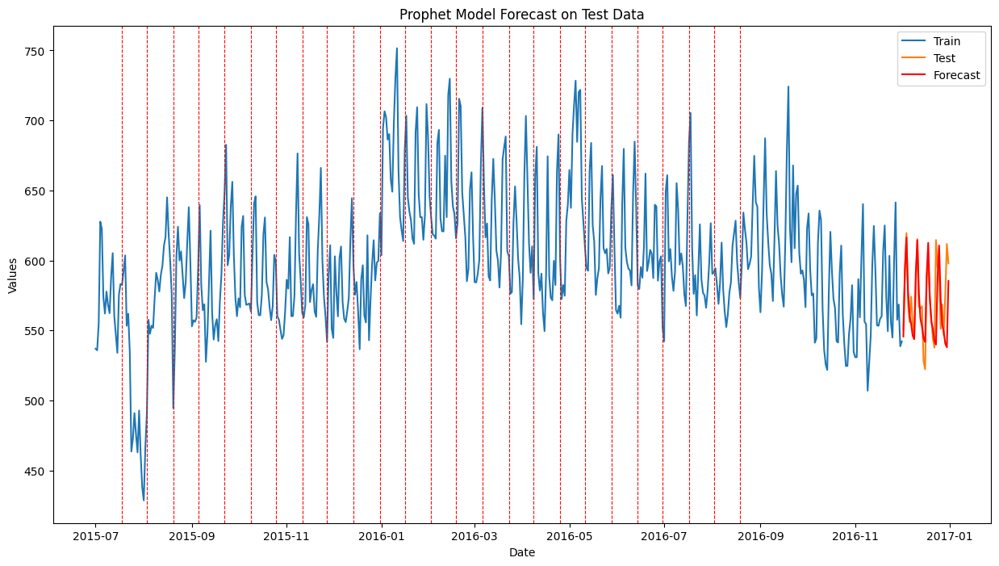

16:46:38 - cmdstanpy - INFO - Chain [1] start processing
16:46:38 - cmdstanpy - INFO - Chain [1] done processing


Train MAPE: 0.03978861671730661
Test MAPE: 0.023946606142878482
Train MSE: 1083.4963437461558
Test MSE: 512.0054089365923
Train RMSE: 32.91650564300767
Test RMSE: 22.627536519395836
LANGUAGE: other


16:46:38 - cmdstanpy - INFO - Chain [1] start processing
16:46:38 - cmdstanpy - INFO - Chain [1] done processing
16:46:38 - cmdstanpy - INFO - Chain [1] start processing
16:46:38 - cmdstanpy - INFO - Chain [1] done processing
16:46:39 - cmdstanpy - INFO - Chain [1] start processing
16:46:39 - cmdstanpy - INFO - Chain [1] done processing
16:46:39 - cmdstanpy - INFO - Chain [1] start processing
16:46:39 - cmdstanpy - INFO - Chain [1] done processing
16:46:39 - cmdstanpy - INFO - Chain [1] start processing
16:46:39 - cmdstanpy - INFO - Chain [1] done processing
16:46:39 - cmdstanpy - INFO - Chain [1] start processing
16:46:39 - cmdstanpy - INFO - Chain [1] done processing
16:46:39 - cmdstanpy - INFO - Chain [1] start processing
16:46:39 - cmdstanpy - INFO - Chain [1] done processing
16:46:39 - cmdstanpy - INFO - Chain [1] start processing
16:46:39 - cmdstanpy - INFO - Chain [1] done processing
16:46:39 - cmdstanpy - INFO - Chain [1] start processing
16:46:39 - cmdstanpy - INFO - Chain [1]

16:46:49 - cmdstanpy - INFO - Chain [1] done processing
16:46:49 - cmdstanpy - INFO - Chain [1] start processing
16:46:49 - cmdstanpy - INFO - Chain [1] done processing
16:46:50 - cmdstanpy - INFO - Chain [1] start processing
16:46:50 - cmdstanpy - INFO - Chain [1] done processing
16:46:50 - cmdstanpy - INFO - Chain [1] start processing
16:46:50 - cmdstanpy - INFO - Chain [1] done processing
16:46:50 - cmdstanpy - INFO - Chain [1] start processing
16:46:50 - cmdstanpy - INFO - Chain [1] done processing
16:46:50 - cmdstanpy - INFO - Chain [1] start processing
16:46:50 - cmdstanpy - INFO - Chain [1] done processing
16:46:50 - cmdstanpy - INFO - Chain [1] start processing
16:46:50 - cmdstanpy - INFO - Chain [1] done processing
16:46:50 - cmdstanpy - INFO - Chain [1] start processing
16:46:50 - cmdstanpy - INFO - Chain [1] done processing
16:46:50 - cmdstanpy - INFO - Chain [1] start processing
16:46:51 - cmdstanpy - INFO - Chain [1] done processing
16:46:51 - cmdstanpy - INFO - Chain [1] 

16:47:01 - cmdstanpy - INFO - Chain [1] done processing
16:47:01 - cmdstanpy - INFO - Chain [1] start processing
16:47:01 - cmdstanpy - INFO - Chain [1] done processing
16:47:01 - cmdstanpy - INFO - Chain [1] start processing
16:47:01 - cmdstanpy - INFO - Chain [1] done processing
16:47:01 - cmdstanpy - INFO - Chain [1] start processing
16:47:01 - cmdstanpy - INFO - Chain [1] done processing
16:47:01 - cmdstanpy - INFO - Chain [1] start processing
16:47:01 - cmdstanpy - INFO - Chain [1] done processing
16:47:01 - cmdstanpy - INFO - Chain [1] start processing
16:47:01 - cmdstanpy - INFO - Chain [1] done processing
16:47:01 - cmdstanpy - INFO - Chain [1] start processing
16:47:02 - cmdstanpy - INFO - Chain [1] done processing
16:47:02 - cmdstanpy - INFO - Chain [1] start processing
16:47:02 - cmdstanpy - INFO - Chain [1] done processing
16:47:02 - cmdstanpy - INFO - Chain [1] start processing
16:47:02 - cmdstanpy - INFO - Chain [1] done processing
16:47:02 - cmdstanpy - INFO - Chain [1] 

Best Prophet config: {'changepoint_prior_scale': 0.5, 'seasonality_prior_scale': 0.5000000000000001} MAPE=0.13067106881464033


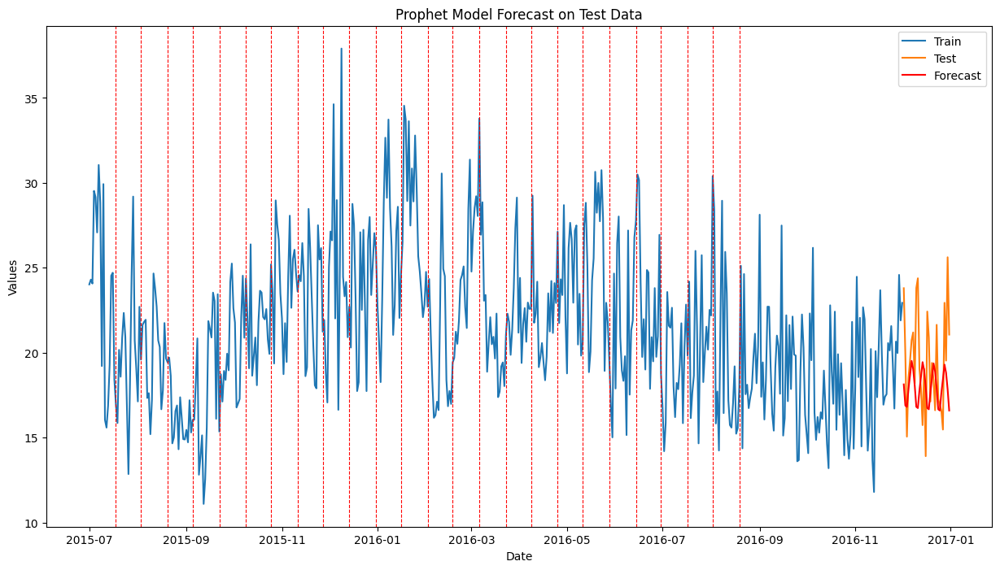

16:47:08 - cmdstanpy - INFO - Chain [1] start processing
16:47:08 - cmdstanpy - INFO - Chain [1] done processing


Train MAPE: 0.14216519882623718
Test MAPE: 0.13067106881464033
Train MSE: 13.46482762154692
Test MSE: 12.25764096220187
Train RMSE: 3.669445138102888
Test RMSE: 3.5010913958652767
LANGUAGE: ru


16:47:08 - cmdstanpy - INFO - Chain [1] start processing
16:47:08 - cmdstanpy - INFO - Chain [1] done processing
16:47:08 - cmdstanpy - INFO - Chain [1] start processing
16:47:08 - cmdstanpy - INFO - Chain [1] done processing
16:47:08 - cmdstanpy - INFO - Chain [1] start processing
16:47:08 - cmdstanpy - INFO - Chain [1] done processing
16:47:08 - cmdstanpy - INFO - Chain [1] start processing
16:47:08 - cmdstanpy - INFO - Chain [1] done processing
16:47:09 - cmdstanpy - INFO - Chain [1] start processing
16:47:09 - cmdstanpy - INFO - Chain [1] done processing
16:47:09 - cmdstanpy - INFO - Chain [1] start processing
16:47:09 - cmdstanpy - INFO - Chain [1] done processing
16:47:09 - cmdstanpy - INFO - Chain [1] start processing
16:47:09 - cmdstanpy - INFO - Chain [1] done processing
16:47:09 - cmdstanpy - INFO - Chain [1] start processing
16:47:09 - cmdstanpy - INFO - Chain [1] done processing
16:47:09 - cmdstanpy - INFO - Chain [1] start processing
16:47:09 - cmdstanpy - INFO - Chain [1]

16:47:20 - cmdstanpy - INFO - Chain [1] done processing
16:47:21 - cmdstanpy - INFO - Chain [1] start processing
16:47:21 - cmdstanpy - INFO - Chain [1] done processing
16:47:21 - cmdstanpy - INFO - Chain [1] start processing
16:47:21 - cmdstanpy - INFO - Chain [1] done processing
16:47:21 - cmdstanpy - INFO - Chain [1] start processing
16:47:21 - cmdstanpy - INFO - Chain [1] done processing
16:47:21 - cmdstanpy - INFO - Chain [1] start processing
16:47:21 - cmdstanpy - INFO - Chain [1] done processing
16:47:21 - cmdstanpy - INFO - Chain [1] start processing
16:47:21 - cmdstanpy - INFO - Chain [1] done processing
16:47:22 - cmdstanpy - INFO - Chain [1] start processing
16:47:22 - cmdstanpy - INFO - Chain [1] done processing
16:47:22 - cmdstanpy - INFO - Chain [1] start processing
16:47:22 - cmdstanpy - INFO - Chain [1] done processing
16:47:22 - cmdstanpy - INFO - Chain [1] start processing
16:47:22 - cmdstanpy - INFO - Chain [1] done processing
16:47:22 - cmdstanpy - INFO - Chain [1] 

16:47:37 - cmdstanpy - INFO - Chain [1] done processing
16:47:37 - cmdstanpy - INFO - Chain [1] start processing
16:47:37 - cmdstanpy - INFO - Chain [1] done processing
16:47:37 - cmdstanpy - INFO - Chain [1] start processing
16:47:37 - cmdstanpy - INFO - Chain [1] done processing
16:47:37 - cmdstanpy - INFO - Chain [1] start processing
16:47:37 - cmdstanpy - INFO - Chain [1] done processing
16:47:38 - cmdstanpy - INFO - Chain [1] start processing
16:47:38 - cmdstanpy - INFO - Chain [1] done processing
16:47:38 - cmdstanpy - INFO - Chain [1] start processing
16:47:38 - cmdstanpy - INFO - Chain [1] done processing
16:47:38 - cmdstanpy - INFO - Chain [1] start processing
16:47:38 - cmdstanpy - INFO - Chain [1] done processing
16:47:38 - cmdstanpy - INFO - Chain [1] start processing
16:47:38 - cmdstanpy - INFO - Chain [1] done processing
16:47:39 - cmdstanpy - INFO - Chain [1] start processing
16:47:39 - cmdstanpy - INFO - Chain [1] done processing
16:47:39 - cmdstanpy - INFO - Chain [1] 

Best Prophet config: {'changepoint_prior_scale': 0.05, 'seasonality_prior_scale': 0.30000000000000004} MAPE=0.07973547215972747


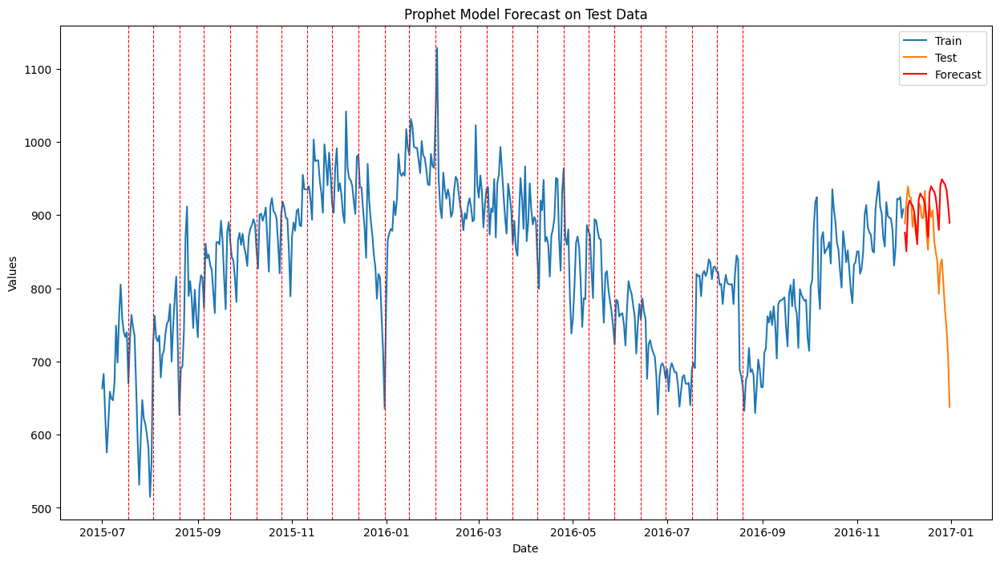

16:47:48 - cmdstanpy - INFO - Chain [1] start processing
16:47:48 - cmdstanpy - INFO - Chain [1] done processing


Train MAPE: 0.047619007135826154
Test MAPE: 0.07973547215972747
Train MSE: 2638.1176079008683
Test MSE: 8344.256273155976
Train RMSE: 51.36260904491582
Test RMSE: 91.34690073098253
LANGUAGE: zh


16:47:48 - cmdstanpy - INFO - Chain [1] start processing
16:47:48 - cmdstanpy - INFO - Chain [1] done processing
16:47:48 - cmdstanpy - INFO - Chain [1] start processing
16:47:48 - cmdstanpy - INFO - Chain [1] done processing
16:47:48 - cmdstanpy - INFO - Chain [1] start processing
16:47:48 - cmdstanpy - INFO - Chain [1] done processing
16:47:48 - cmdstanpy - INFO - Chain [1] start processing
16:47:48 - cmdstanpy - INFO - Chain [1] done processing
16:47:48 - cmdstanpy - INFO - Chain [1] start processing
16:47:49 - cmdstanpy - INFO - Chain [1] done processing
16:47:49 - cmdstanpy - INFO - Chain [1] start processing
16:47:49 - cmdstanpy - INFO - Chain [1] done processing
16:47:49 - cmdstanpy - INFO - Chain [1] start processing
16:47:49 - cmdstanpy - INFO - Chain [1] done processing
16:47:49 - cmdstanpy - INFO - Chain [1] start processing
16:47:49 - cmdstanpy - INFO - Chain [1] done processing
16:47:49 - cmdstanpy - INFO - Chain [1] start processing
16:47:49 - cmdstanpy - INFO - Chain [1]

16:47:59 - cmdstanpy - INFO - Chain [1] done processing
16:47:59 - cmdstanpy - INFO - Chain [1] start processing
16:47:59 - cmdstanpy - INFO - Chain [1] done processing
16:47:59 - cmdstanpy - INFO - Chain [1] start processing
16:47:59 - cmdstanpy - INFO - Chain [1] done processing
16:48:00 - cmdstanpy - INFO - Chain [1] start processing
16:48:00 - cmdstanpy - INFO - Chain [1] done processing
16:48:00 - cmdstanpy - INFO - Chain [1] start processing
16:48:00 - cmdstanpy - INFO - Chain [1] done processing
16:48:00 - cmdstanpy - INFO - Chain [1] start processing
16:48:00 - cmdstanpy - INFO - Chain [1] done processing
16:48:00 - cmdstanpy - INFO - Chain [1] start processing
16:48:00 - cmdstanpy - INFO - Chain [1] done processing
16:48:00 - cmdstanpy - INFO - Chain [1] start processing
16:48:00 - cmdstanpy - INFO - Chain [1] done processing
16:48:00 - cmdstanpy - INFO - Chain [1] start processing
16:48:00 - cmdstanpy - INFO - Chain [1] done processing
16:48:00 - cmdstanpy - INFO - Chain [1] 

16:48:12 - cmdstanpy - INFO - Chain [1] done processing
16:48:12 - cmdstanpy - INFO - Chain [1] start processing
16:48:12 - cmdstanpy - INFO - Chain [1] done processing
16:48:12 - cmdstanpy - INFO - Chain [1] start processing
16:48:12 - cmdstanpy - INFO - Chain [1] done processing
16:48:12 - cmdstanpy - INFO - Chain [1] start processing
16:48:12 - cmdstanpy - INFO - Chain [1] done processing
16:48:12 - cmdstanpy - INFO - Chain [1] start processing
16:48:12 - cmdstanpy - INFO - Chain [1] done processing
16:48:12 - cmdstanpy - INFO - Chain [1] start processing
16:48:13 - cmdstanpy - INFO - Chain [1] done processing
16:48:13 - cmdstanpy - INFO - Chain [1] start processing
16:48:13 - cmdstanpy - INFO - Chain [1] done processing
16:48:13 - cmdstanpy - INFO - Chain [1] start processing
16:48:13 - cmdstanpy - INFO - Chain [1] done processing
16:48:13 - cmdstanpy - INFO - Chain [1] start processing
16:48:13 - cmdstanpy - INFO - Chain [1] done processing
16:48:13 - cmdstanpy - INFO - Chain [1] 

Best Prophet config: {'changepoint_prior_scale': 0.05, 'seasonality_prior_scale': 0.20000000000000004} MAPE=0.027268276647733243


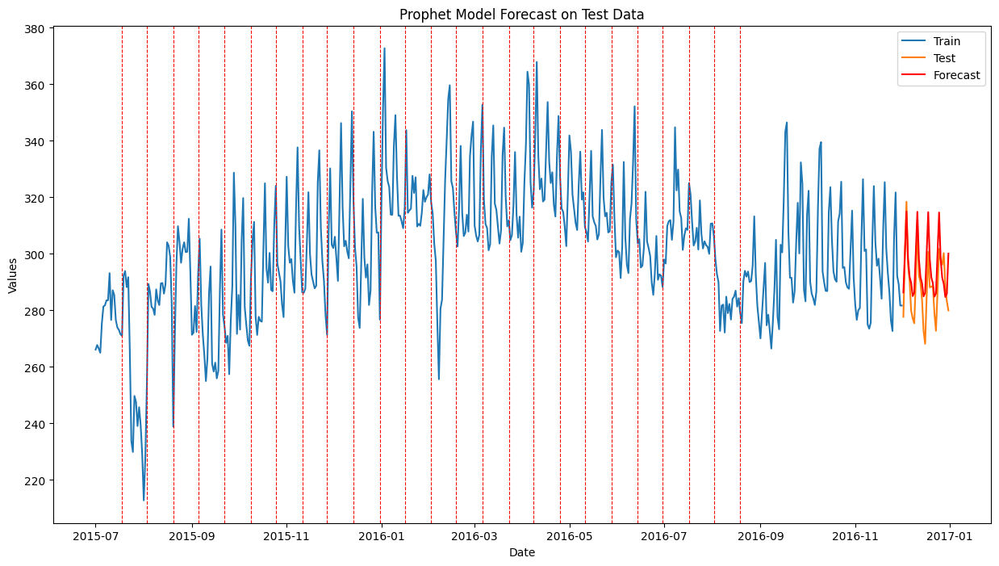

Train MAPE: 0.036335872640547974
Test MAPE: 0.027268276647733243
Train MSE: 218.84833476612744
Test MSE: 89.67072376902092
Train RMSE: 14.793523406076304
Test RMSE: 9.46946269695493


In [27]:
def analyze_prophet(train, test, param_grid):
    # Ensure 'ds' is the datetime and 'y' is the value
    train['ds'] = pd.to_datetime(train.index)
    train['y'] = train['y']
    test['ds'] = pd.to_datetime(test.index)
    test['y'] = test['y']
    
    best_model, best_cfg, best_forecast = prophet_grid_search(train, test, param_grid)
    
    # Plot train, test, and forecast
    plot_forecast(best_model, train, test, best_forecast, 'Prophet Model Forecast on Test Data')
    
    # Calculate MAPE for train and test data
    train_forecast = best_model.predict(train)['yhat']
    train_mape = mape(train['y'], train_forecast)
    test_mape = mape(test['y'], best_forecast)
    

    train_mse = mse(train['y'], train_forecast)
    test_mse = mse(test['y'], best_forecast)
    train_rmse = np.sqrt(train_mse)
    test_rmse = np.sqrt(test_mse)
    
    print(f'Train MAPE: {train_mape}')
    print(f'Test MAPE: {test_mape}')
    print(f'Train MSE: {train_mse}')
    print(f'Test MSE: {test_mse}')
    print(f'Train RMSE: {train_rmse}')
    print(f'Test RMSE: {test_rmse}')

    
# Define the parameter grid
changepoint_prior_scale=np.arange(0.05,0.55,0.05)
seasonality_prior_scale=np.arange(0.1,1.05,0.05)

param_grid=[{'changepoint_prior_scale':item[0],'seasonality_prior_scale':item[1]} for item in list(product(changepoint_prior_scale, seasonality_prior_scale))]

# Iterate over your datasets
for ind in train_dataset2.index:
    print('==================================================================')
    print('LANGUAGE: {}'.format(ind))
    
    t1=train_dataset2.loc[ind].to_frame()
    t1.columns=['y']
    t2=test_dataset2.loc[ind].to_frame()
    t2.columns=['y']
    
    if ind == 'en':
        exog_d.index=exog_d.index.astype(str)
        t1['exog']=exog_d.loc[t1.index,'Exog']
        t2['exog']=exog_d.loc[t2.index,'Exog']
        analyze_prophet(t1, t2, param_grid)
    else:
        analyze_prophet(t1, t2, param_grid)

In [28]:

#views are high at campaign/holidays


<span style="font-size: 14px;">The best performing SARIMA models for different languages show varying levels of forecast accuracy. For instance, the MAPE (Mean Absolute Percentage Error) for German (de) pages is 1.8%, which is lower than the 9.9% for Spanish (es) pages, indicating that the German model is more accurate. The Spanish model has some remaining unexplained seasonality, suggesting that the chosen SARIMA parameters might need further refinement or that additional seasonal components should be considered.</span>

<span style="font-size: larger;">==========================<br>Hypothesis testing<br>==========================</span>

In [29]:
#Hypothesis test

from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf

def anova_lm_test(data, col, tar):
    # Perform ANOVA (Analysis of Variance)
    formula = f'{col} ~ C({tar})'
    model = smf.ols(formula, data=data).fit()
    anova_table = sm.stats.anova_lm(model, typ=2)
    
    print(anova_table)
    
    p_value = anova_table["PR(>F)"][0]
    if p_value < 0.05:
        print(f'There is a statistically significant difference between the mean {col} across the groups in {tar}.')
        return 1
    else:
        print('There is no sufficient evidence of a significant difference between the means across the groups.')
        return 0

def cat_chi2test(data,col,tar):

    contingency_table=pd.crosstab(data[tar],data[col])
    print(contingency_table)

    chi2,p,dof,expected=stats.chi2_contingency(contingency_table)
    print('chi2: {} with p_value: {}'.format(chi2,p))
    if p<0.05:
        print('There is a statistically significant association between {} and {}.'.format(col,tar))
        return 1
    else:
        print('There is no sufficient evidence of a significant association between {} and {}.'.format(col,tar))
        return 0
    
info['daily_mean_views']=data.loc[:,data.columns[1:]].mean(axis=1)

In [30]:
cat_cols=['language','access_type','access_origin']
for col in range(len(cat_cols)):
    for target_var in range(col+1,len(cat_cols)):
        print('=============== {}-{} ================\n'.format(cat_cols[col],cat_cols[target_var]))
        print('\n')
        f=cat_chi2test(info,cat_cols[col],cat_cols[target_var])
        
        

=============== language-access_type ================



language       de     en    es    fr    ja  other    ru    zh
access_type                                                  
all-access   8282  11877  6542  8142  9334    402  6802  6784
desktop      3928   4277  3033  3642  4782    198  3426  3341
mobile-web   4436   4184  3459  4361  4545    281  3437  3470
chi2: 588.1512255244766 with p_value: 1.7657410778223675e-116
There is a statistically significant association between language and access_type.
=============== language-access_origin ================



language          de     en    es     fr     ja  other     ru     zh
access_origin                                                       
all-agents     12505  16064  9763  12074  13994    680  10264  10203
spider          4141   4274  3271   4071   4667    201   3401   3392
chi2: 146.09802957292482 with p_value: 2.6766224604262142e-28
There is a statistically significant association between language and access_origin.
======

In [31]:
numeric_cols=['daily_mean_views']
for col in numeric_cols:
    for target_var in cat_cols:
        print('=============== {}-{} ================\n'.format(col,target_var),info.groupby([target_var])[col].describe())
        print('\n')
        f=anova_lm_test(info,col,target_var)
        
        

=============== daily_mean_views-language ================
             count         mean            std       min         25%  \
language                                                              
de        16646.0   939.302602   28539.854894  0.100182   40.204545   
en        20338.0  5065.330412  195635.611027  0.155109   52.736818   
es        13034.0  1290.097238   15805.449172  0.016364   59.761364   
fr        16145.0   677.911126   15751.535944  0.125455   39.543636   
ja        18661.0   799.427149    3823.055692  0.917582  125.874545   
other       881.0    29.661316      36.360399  0.666031    3.438182   
ru        13665.0  1031.748093   21230.682845  0.020000   60.698182   
zh        13595.0   358.446728    2621.912866  0.807273   34.034545   

                  50%          75%           max  
language                                          
de         298.628182   693.746818  2.916244e+06  
en        1179.243636  3536.858636  2.193851e+07  
es         693.827273  14

<span style="font-size: 14px;">Chi-square test shows a statistically significant association between the type of access (e.g., desktop, mobile-web) and the origin of the viewer (e.g., all-agents or spiders). However, there is no significant difference in mean daily views across different access types. This suggests that while access type and origin are related, the overall volume of views is relatively consistent regardless of access type.</span>

The significant association between access type and origin suggests that targeted ad campaigns could be optimized by focusing on specific combinations. For instance, targeting desktop users with all-agents origin could be more effective than a generalized campaign across all access types.


In [32]:
exog_d['mean_page_views']=data.loc[info.language=='en',data.columns[1:]].mean(axis=0)

numeric_cols=['mean_page_views']
for col in numeric_cols:
    for target_var in ['Exog']:
        print('=============== {}-{} ================\n'.format(col,target_var),exog_d.groupby([target_var])[col].describe())
        print('\n')
        f=anova_lm_test(exog_d,col,target_var)

=============== mean_page_views-Exog ================
       count         mean          std          min          25%          50%  \
Exog                                                                           
0     496.0  4817.302537   535.771982  3773.380519  4407.919801  4754.754704   
1      54.0  7621.301159  1441.614118  4664.241580  6648.148910  7406.976039   

              75%          max  
Exog                            
0     5210.226852  6495.108235  
1     8986.194327  9642.986780  


                sum_sq     df           F         PR(>F)
C(Exog)   3.828850e+08    1.0  831.837722  5.684928e-112
Residual  2.522379e+08  548.0         NaN            NaN
There is a statistically significant difference between the mean mean_page_views across the groups in Exog.


<span style="font-size: 14px;">ANOVA results for Exog (an exogenous variable, potentially related to campaign days or holidays) show a significant difference in mean page views. This indicates that external factors like campaigns or holidays have a strong influence on viewership</span>

<span style="font-size: 14px;"><b>Questionnaire:</b><br>

<b>1. Defining the problem statements and where can this and modifications of this be used?</b>
</span>

<span style="font-size: 14px;"><b>Problem Statement:</b><br>
AdEase aims to optimize ad placements on Wikipedia pages by forecasting the number of page views. Given that different Wikipedia pages attract varying levels of attention based on language, access type, and origin, it's essential to predict future page views accurately. This will allow AdEase to provide its clients with data-driven insights on where to place ads for maximum impact.

<b>Potential Uses and Modifications:</b>

1. Ad Placement Optimization: By predicting the number of views for different Wikipedia pages, AdEase can determine the best pages to place ads for different clients, ensuring they get maximum exposure.
2. Targeted Marketing Campaigns: Understanding which languages and regions receive the most views can help businesses tailor their marketing campaigns to those specific demographics.
3. Seasonal Campaigns: The observed weekly seasonality can be leveraged to run targeted campaigns during peak view periods.
4. Expanding to Other Platforms: The methodology can be extended to other platforms where AdEase operates, such as news websites or social media platforms, for optimizing ad placements based on user engagement patterns.
5. Dynamic Pricing Models: The data can be used to develop a dynamic pricing model for ad placements, where clients pay more for ads placed on high-traffic pages or during peak times.
</span>

<b>2. Write inferences you made from the data visualizations</b>

1. The initially high number of nulls suggests that many of these pages did not exist during the earlier part of the timeline.
2. 75.7% of the pages were viewed by agents, while the rest were viewed by spiders (automated bots). The majority of average daily views were observed from all-agents (96%).

3. The top 3 languages for the pages are English (18%), Japanese (16.5%), and German (14.7%); where English(accounts for 49.7% of daily average views) and Spanish(accounts for 12.6% of daily average views) pages are the most viewed, indicating that these languages are crucial for targeting international audiences.

4. The highest average daily views were observed from desktop users (38%), followed by all-access users (32%).

5. Chi-square test shows a statistically significant association between the type of access (e.g., desktop, mobile-web) and the origin of the viewer (e.g., all-agents or spiders). However, there is no significant difference in mean daily views across different access types. This suggests that while access type and origin are related, the overall volume of views is relatively consistent regardless of access type. The significant association between access type and origin suggests that targeted ad campaigns could be optimized by focusing on specific combinations. For instance, targeting desktop users with all-agents origin could be more effective than a generalized campaign across all access types.

6. ANOVA results for Exog (an exogenous variable, potentially related to campaign days or holidays) show a significant difference in mean page views. This indicates that external factors like campaigns or holidays have a strong influence on viewership


<b>3. What does the decomposition of series do?</b>


Decomposition of time series helps to break down the series into its underlying components: trend, seasonality, and noise (residuals). This process is crucial for understanding the behavior of the time series data. By decomposing the series, we can:
1. Identify the overall trend in the data (e.g., increasing or decreasing page views).
2. Understand the seasonality pattern (e.g., weekly peaks in page views).
3. Analyze the residuals to determine if the data is stationary and to identify any anomalies or outliers.


<b>4. What level of differencing gave you a stationary series?</b>


Languages such as German (de), English (en), French (fr), Japanese (ja), Russian (ru), and Chinese (zh) show stationarity in mean page views across the timeline after differencing once. On the other hand, Spanish (es) and other languages (less than 0.1% of the dataset) are already stationary.The stationary nature of Spanish and other less common languages without differencing indicates more stable and consistent view patterns over time, which could imply a steady audience or less content volatility. We also know Spanish language accounts for 12.6% of daily average views, which suggests most of regular, returning and consistent users view Spanish wiki pages.



<b>5. Difference between arima, sarima & sarimax.</b>


1. <b>ARIMA (AutoRegressive Integrated Moving Average):</b>
Captures autocorrelation (AR), differencing to achieve stationarity (I), and moving average (MA) components.
Suitable for univariate time series without seasonality.

2. <b>SARIMA (Seasonal ARIMA):</b>
Extends ARIMA by including seasonal components (e.g., weekly or yearly seasonality).
Suitable for univariate time series with seasonality.

3. <b>SARIMAX (Seasonal ARIMA with Exogenous Variables):</b>
Further extends SARIMA by allowing the inclusion of exogenous variables (e.g., holidays, special events).
Suitable for univariate time series with seasonality and additional external factors influencing the data.



<b>6. Compare the number of views in different languages</b>

English(accounts for 49.7% of daily average views) and Spanish(accounts for 12.6% of daily average views) pages are the most viewed, indicating that these languages are crucial for targeting international audiences.
Also most of regular, returning and consistent users view Spanish wiki pages.
English Pages: Highest average daily views, making it a critical target for English-speaking markets.


<b>7. What other methods other than grid search would be suitable to get the model for all languages?</b>


1. Bayesian Optimization: Instead of grid search, Bayesian optimization can be used to find the best model parameters more efficiently by building a probabilistic model and focusing on promising areas of the parameter space.
2. Random Search: Random search can explore a broader range of parameter combinations than grid search and often finds near-optimal solutions faster.
